Find and screen top conserved markers based on list of differentially expressed markers

# Run first: Define functions, load and pre-process data (imputation, gene names)

In [1]:
## conda activate r4
## packages for data table processing

#IRkernel::installspec()

## main Seurat package snRNA-seq packages
library(Seurat)
library(SeuratDisk)
library(SeuratWrappers)
library(future)

library(here)
library(tidyverse)

library(dplyr)

library(caret)
library(cluster)

#install.packages('hash')
library(hash)

library(ggpubr)
library(ggplot2)
library(viridis)
options(repr.plot.width=30, repr.plot.height=10)

ss <- function(x, pattern, slot = 1, ...) { 
  sapply(strsplit(x = x, split = pattern, ...), '[', slot) }
options(stringsAsFactors = F)
options(repr.plot.width=11, repr.plot.height=8.5)

#######################################################
# 0) Seurat uses the future package for parallelization
## set to be parallel over 28 cores
plan("multicore", workers = 28)
options(future.globals.maxSize = 100 * 1024^3)
options(future.rng.onMisuse = 'ignore')

Warning message:
“package ‘Seurat’ was built under R version 4.1.3”
Attaching SeuratObject

Registered S3 method overwritten by 'SeuratDisk':
  method            from  
  as.sparse.H5Group Seurat

Warning message:
“package ‘future’ was built under R version 4.1.3”
Warning message:
“package ‘here’ was built under R version 4.1.3”
here() starts at /projects/pfenninggroup/singleCell/Macaque_SealDorsalHorn_snATAC-seq

── Attaching packages ─────────────────────────────────────────────────────────────────────────────────────────────── tidyverse 1.3.1 ──

✔ ggplot2 3.4.0     ✔ purrr   0.3.4
✔ tibble  3.1.7     ✔ dplyr   1.0.9
✔ tidyr   1.2.0     ✔ stringr 1.4.0
✔ readr   2.1.2     ✔ forcats 0.5.1

Warning message:
“package ‘ggplot2’ was built under R version 4.1.3”
Warning message:
“package ‘tibble’ was built under R version 4.1.3”
Warning message:
“package ‘dplyr’ was built under R version 4.1.3”
── Conflicts ──────────────────────────────────────────────────────────────────────────────────

In [2]:
FeatureScatterFunction <- function(name, obj, feature1, feature2, focus, opponent = NULL) {
    
        if (missing(opponent)){
            obj$temp_groups = if_else(as.character(Idents(obj)) != focus, 'Other', as.character(Idents(obj)))
        } else{
            obj$temp_groups = if_else(as.character(Idents(obj)) %in% c(focus,opponent), as.character(Idents(obj)), 'Other')
        }
            
    if (name == 'mouse'){
        feature1 = as.character(HgtoMm[feature1])
        feature2 = as.character(HgtoMm[feature2])
        }

    FeatureScatter(obj,feature1=feature1,feature2=feature2, group.by = 'temp_groups',
                       smooth  =FALSE, pt.size = 1, jitter = TRUE) + ggtitle(name) + (aes(colour = temp_groups))
}

In [3]:
### mouse genes to human genes
convertHumanGeneList <- function(x){
  file = '/home/bnphan/resources/genomes/GRCh38.p13/ENSEMBL_GRCh38.p13_genes_to_Orthologous_mouse_genes.tsv'
  orthologs = read_tsv(file, show_col_types = FALSE) %>% 
    rename_with(make.names) %>% 
    dplyr::filter(Mouse.homology.type== 'ortholog_one2one') %>% 
    dplyr::filter(Mouse.gene.name %in% x) %>% 
    dplyr::select(Mouse.gene.name, Gene.name)
  
  # Print the first 6 genes found to the screen
  print(head(orthologs))
  return(orthologs)
}
# RenameGenesSeurat from https://github.com/satijalab/seurat/issues/1049
RenameGenesSeurat <- function(obj, newnames) {
  # Replace gene names in different slots of a Seurat object. Run this before integration.
  # It only changes obj@assays$RNA@counts, @data and @scale.data.
  print("Run this before integration. It only changes obj@assays$RNA@counts, @data and @scale.data.")
  RNA <- obj@assays$RNA

  if (nrow(RNA) == length(newnames)) {
    if (length(RNA@counts)) RNA@counts@Dimnames[[1]]            <- newnames
    if (length(RNA@data)) RNA@data@Dimnames[[1]]                <- newnames
    if (length(RNA@scale.data)) RNA@scale.data@Dimnames[[1]]    <- newnames
  } else {"Unequal gene sets: nrow(RNA) != nrow(newnames)"}
  obj@assays$RNA <- RNA
  return(obj)
}

#Mouse_xenium_hy= convertHumanGeneList(rownames(mouse_rna))

In [4]:
# load datasets
filename = "/projects/pfenninggroup/singleCell/Macaque_SealDorsalHorn_snATAC-seq/data/tidy_data/rdas/mouse_rna_dh_conserved_names.h5seurat"
mouse_rna = LoadH5Seurat(filename)

filename = "/projects/pfenninggroup/singleCell/Macaque_SealDorsalHorn_snATAC-seq/data/tidy_data/rdas/human_rna_dh_conserved_names.h5seurat"
human_rna_dh = LoadH5Seurat(filename)

filename = "/projects/pfenninggroup/singleCell/Macaque_SealDorsalHorn_snATAC-seq/data/tidy_data/rdas/macaque_rna_dh_conserved_names.h5seurat"
macaque_rna_dh = LoadH5Seurat(filename)


### mouse genes to human genes
convertHumanGeneList <- function(x){
  file = '/home/bnphan/resources/genomes/GRCh38.p13/ENSEMBL_GRCh38.p13_genes_to_Orthologous_mouse_genes.tsv'
  orthologs = read_tsv(file, show_col_types = FALSE) %>% 
    rename_with(make.names) %>% 
    dplyr::filter(Mouse.homology.type== 'ortholog_one2one') %>% 
    dplyr::filter(Mouse.gene.name %in% x) %>% 
    dplyr::select(Mouse.gene.name, Gene.name)
  
  # Print the first 6 genes found to the screen
  print(head(orthologs))
  return(orthologs)
}
# RenameGenesSeurat from https://github.com/satijalab/seurat/issues/1049
RenameGenesSeurat <- function(obj, newnames) {
  # Replace gene names in different slots of a Seurat object. Run this before integration.
  # It only changes obj@assays$RNA@counts, @data and @scale.data.
  print("Run this before integration. It only changes obj@assays$RNA@counts, @data and @scale.data.")
  RNA <- obj@assays$RNA

  if (nrow(RNA) == length(newnames)) {
    if (length(RNA@counts)) RNA@counts@Dimnames[[1]]            <- newnames
    if (length(RNA@data)) RNA@data@Dimnames[[1]]                <- newnames
    if (length(RNA@scale.data)) RNA@scale.data@Dimnames[[1]]    <- newnames
  } else {"Unequal gene sets: nrow(RNA) != nrow(newnames)"}
  obj@assays$RNA <- RNA
  return(obj)
}

## switch out human gene names w/ orthologous mouse gene names, based on ENSEMBL
MmtoHg = convertHumanGeneList(rownames(mouse_rna)) %>% deframe()
HgtoMm = setNames(names(MmtoHg), MmtoHg)
# mouse_rna = mouse_rna[names(MmtoHg[!is.na(MmtoHg)]), ]
# mouse_rna = RenameGenesSeurat(mouse_rna, newnames = MmtoHg[rownames(mouse_rna)])
# mouse_rna = mouse_rna[!is.na(rownames(mouse_rna)), ]
# head(rownames(mouse_rna))

# firstup <- function(x) {
#   substr(x, 1, 1) <- toupper(substr(x, 1, 1))
#   x
# }

#Final set of features
features = c('BNC2','HMGA2','NMUR2','PREX2','NMU','TAC3',' COL5A2', 'PLCH1','LMO3', 'TRPC3','SKOR2', 'NELL2','MAF','ADARB2', 'MAFA', 'NTS','TSHZ2', 'SNTB1', 'TRH','DACH1','PBX3','SLIT2',
            'CACNA2D3','TCF4', 'SORCS1','SDK1', 'PDZD2','SGCD', 'NPY','ZIC1', 'MEF2C','RORB','NXPH1', 'SDK2','PDYN','PTPRK')
mouse_features = as.character(HgtoMm[features])

macaque_ordered_types = c('GLUT1','GLUT2','GLUT3','GLUT4','GLUT5','GLUT6','GLUT7','GLUT8','GLUT9','GLUT10','GLUT11',
                          'GABA1','GABA2_1','GABA2_2','GABA3','GABA4_2','GABA4_1','GABA5')
new_cell_names = c('Exc-BNC2/HMGA2','Exc-NMUR2/PREX2', 'Exc-NMU/TAC3', 'Exc-TAC3/COL5A2/PLCH1','Exc-LMO3/TRPC3', 'Exc-SKOR2/NELL2', 'Exc-MAF/ADARB2', 'Exc-MAFA/BNC2', 
                  'Exc-NTS/TSHZ2', 'Exc-SNTB1/TRH/DACH1', 'Exc-PBX3/SLIT2', 
                  'Inh-CACNA2D3/TCF4', 'Inh-SORCS1/SDK1', 'Inh-PDZD2/SGCD', 'Inh-NPY/ZIC1', 'Inh-MEF2C/RORB','Inh-NXPH1/SDK2','Inh-PDYN/PTPRK')

names(new_cell_names) = macaque_ordered_types
new_cell_nicknames = c('Exc-BNC2','Exc-NMUR2', 'Exc-NMU', 'Exc-TAC3','Exc-LMO3', 'Exc-SKOR2', 'Exc-MAF', 'Exc-MAFA', 
                  'Exc-NTS', 'Exc-SNTB1', 'Exc-PBX3', 'Inh-CACNA2D3', 'Inh-SORCS1', 'Inh-PDZD2', 'Inh-NPY', 'Inh-MEF2C','Inh-NXPH1','Inh-PDYN')
names(new_cell_nicknames) = macaque_ordered_types

Idents(object = mouse_rna) <- factor(x = mouse_rna$conserved_marker_nicknames, levels = new_cell_nicknames)
Idents(object = macaque_rna_dh) <- factor(x = macaque_rna_dh$conserved_marker_nicknames, levels = new_cell_nicknames)
Idents(object = human_rna_dh) <- factor(x = human_rna_dh$conserved_marker_nicknames, levels = new_cell_nicknames)


Validating h5Seurat file

Initializing MAGIC_RNA with data

Adding miscellaneous information for MAGIC_RNA

Initializing MAGIC_SCT with data

Adding miscellaneous information for MAGIC_SCT

Initializing RNA with data

Adding counts for RNA

Adding miscellaneous information for RNA

Initializing SCT with data

Adding counts for SCT

Adding scale.data for SCT

Adding variable feature information for SCT

Adding miscellaneous information for SCT

Initializing alra with data

Adding scale.data for alra

Adding miscellaneous information for alra

Initializing integrated with data

Adding scale.data for integrated

Adding variable feature information for integrated

Adding miscellaneous information for integrated

Adding reduction pca

Adding cell embeddings for pca

Adding feature loadings for pca

Adding miscellaneous information for pca

Adding reduction umap

Adding cell embeddings for umap

Adding miscellaneous information for umap

Adding command information

Adding cell-level metadata

# A tibble: 6 × 2
  Mouse.gene.name Gene.name
  <chr>           <chr>    
1 Frg1            NA       
2 Usp9y           USP9Y    
3 Usp9y           USP9Y    
4 Usp9y           USP9Y    
5 Usp9y           USP9Y    
6 Usp9y           USP9Y    


# Historical Markers

In [7]:
transporters = c('SLC17A7', 'SLC17A6','SLC17A8','SLC6A5', 'SLC32A1')  
specific_markers = c('NPY1R','GRPR', 'SST', 'CCK','GRP','RORB','TAC1','LYPD1','TRH', 
                        'PRKCG', 'UCN3','TLX3','TACR1','BHLHE22','CALB2','NOS1', 'NPR1', 'NPY','GAL', 'PDYN')
historical_markers0 = c('LMX1B','RORA', 'NOS1', 'RET', 'PVALB', 'RELN')
cant_find_try_other_species = c('GPR83','NPFF')

# https://elifesciences.org/reviewed-preprints/86633v2
todd_markers = c('CALB2', 'NOS1', 'PDYN', 'GAL', 'NPY')

mouse_transporters = as.character(HgtoMm[transporters])
mouse_specific_markers= as.character(HgtoMm[specific_markers])
mouse_historical_markers0 = as.character(HgtoMm[historical_markers0])
mouse_cant_find = as.character(HgtoMm[cant_find_try_other_species])
mouse_todd_markers = as.character(HgtoMm[todd_markers])

In [5]:
DefaultAssay(mouse_rna) <- "SCT"
DefaultAssay(human_rna_dh) <- "SCT"
DefaultAssay(macaque_rna_dh) <- "SCT"

In [35]:
##### Transporters

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_transporters_mouse.png'),
   width=7,height=2.5,units="in",res=1200)

DoHeatmap(object = mouse_rna, features = mouse_transporters,slot = 'data', size = 3, angle=90) + scale_fill_viridis() + ggtitle('') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_transporters_macaque.png'),
   width=7,height=2.5,units="in",res=1200)

DoHeatmap(object = macaque_rna_dh, features = transporters, slot = 'data', size = 3, angle=90) + scale_fill_viridis() + ggtitle('') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_transporters_human.png'),
   width=7,height=2.5,units="in",res=1200)

DoHeatmap(object = human_rna_dh, features = transporters, slot = 'data', size = 3, angle=90) + scale_fill_viridis() + ggtitle('') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Warning message in DoHeatmap(object = human_rna_dh, features = transporters, slot = "data", :
“The following features were omitted as they were not found in the data slot for the SCT assay: SLC17A7”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

In [9]:
### Unscaled Specific Marker Genes - show that there is enough expression for comparisons

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_historical_specific_mouse.png'),
   width=7,height=5,units="in",res=1200)

DoHeatmap(object = mouse_rna, features = mouse_specific_markers,slot = 'data', size = 3, angle=90) + ggtitle('Mouse \n\n') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_historical_specific_macaque.png'),
   width=7,height=4.5,units="in",res=1200)

DoHeatmap(object = macaque_rna_dh, features = specific_markers, slot = 'data', size = 3, angle=90) + ggtitle('Macaque \n\n') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

png(filename=here('figures/exploratory/arokiaraj_paper/marker_genes/unscaled_historical_specific_human.png'),
   width=7,height=4.5,units="in",res=1200)

DoHeatmap(object = human_rna_dh, features = specific_markers, slot = 'data', size = 3, angle=90) + ggtitle('Human \n\n') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=12), axis.text=element_text(size=10)) + guides(colour=FALSE)

dev.off()

png 
  2

png 
  2

Warning message in DoHeatmap(object = human_rna_dh, features = specific_markers, :
“The following features were omitted as they were not found in the data slot for the SCT assay: NPR1”


png 
  2

# Cell type names and Final set of features

In [29]:
colors_macaque = c('#0075DC','#993F00','#4C005C','#191919','#005C31','#2BCE48','#FFCC99','#808080','#94FFB5','#8F7C00','#9DCC00',
         '#C20088','#003380','#FFA405','#5EF1F2','#FFA8BB','#426600','#FF0010')
colors_human = c('#0075DC',  '#993F00','#4C005C','#191919','#005C31','#2BCE48','#FFCC99','#808080','#94FFB5','#8F7C00','#9DCC00',
         '#C20088','#003380','#FFA405',          '#FFA8BB','#426600','#FF0010')


# must reverse to match umap
colors_macaque = rev(colors_macaque)
colors_human = rev(colors_human)
length(colors_macaque)
length(colors_human)

[1] 18

[1] 17

# Conserved Marker Heatmaps

In [30]:
DefaultAssay(mouse_rna) <- "alra"
DefaultAssay(human_rna_dh) <- "alra"
DefaultAssay(macaque_rna_dh) <- "alra"


### Macaque

filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/macaque_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = macaque_rna_dh, features = features,slot = 'scale.data', size = 3, angle = 45, group.colors = colors_macaque) +
ggtitle('Macaque') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "right", plot.margin = margin(1,0,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()

filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/human_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = human_rna_dh, features = features,slot = 'scale.data', size = 3, angle = 45, group.colors = colors_human) +
ggtitle('Human') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "none", plot.margin = margin(1,1,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()


filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/mouse_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = mouse_rna, features = mouse_features,slot = 'scale.data', size = 3, angle = 45, group.colors = colors_macaque) +
ggtitle('Mouse') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "none", plot.margin = margin(1,1,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()



Warning message in DoHeatmap(object = macaque_rna_dh, features = features, slot = "scale.data", :
“The following features were omitted as they were not found in the scale.data slot for the alra assay:  COL5A2”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Warning message in DoHeatmap(object = human_rna_dh, features = features, slot = "scale.data", :
“The following features were omitted as they were not found in the scale.data slot for the alra assay:  COL5A2”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Warning message in DoHeatmap(object = mouse_rna, features = mouse_features, slot = "scale.data", :
“The following features were omitted as they were not found in the scale.data slot for the alra assay: NA”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

In [31]:
### checked unscaled and non-imputed
DefaultAssay(mouse_rna) <- "SCT"
DefaultAssay(human_rna_dh) <- "SCT"
DefaultAssay(macaque_rna_dh) <- "SCT"

### Macaque

filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/unscaled_macaque_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = macaque_rna_dh, features = features,slot = 'data', size = 3, angle = 45, group.colors = colors_macaque) +
ggtitle('Macaque') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "right", plot.margin = margin(1,0,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()

filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/unscaled_human_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = human_rna_dh, features = features,slot = 'data', size = 3, angle = 45, group.colors = colors_human) +
ggtitle('Human') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "none", plot.margin = margin(1,1,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()


filename_prefix = here(paste0("figures/exploratory/arokiaraj_paper/marker_genes/unscaled_mouse_conserved_heatmap_",Sys.Date()))
#pdf(paste0(filename_prefix,'.pdf'))
tiff(paste0(filename_prefix,'.tiff'), units="in", width=7.5, height=5, res=300)
DoHeatmap(object = mouse_rna, features = mouse_features,slot = 'data', size = 3, angle = 45, group.colors = colors_macaque) +
ggtitle('Mouse') +
theme(plot.title=element_text(family='', face='bold', colour='black', size=0), 
      # margin(t = 0, r = 0, b = 0, l = 0
      axis.text=element_text(size=10),legend.position = "none", plot.margin = margin(1,1,0,0, "cm")) + guides(color="none") + 
scale_fill_viridis()

dev.off()

Warning message in DoHeatmap(object = macaque_rna_dh, features = features, slot = "data", :
“The following features were omitted as they were not found in the data slot for the SCT assay:  COL5A2”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Warning message in DoHeatmap(object = human_rna_dh, features = features, slot = "data", :
“The following features were omitted as they were not found in the data slot for the SCT assay:  COL5A2”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

Warning message in DoHeatmap(object = mouse_rna, features = mouse_features, slot = "data", :
“The following features were omitted as they were not found in the data slot for the SCT assay: NA”
Scale for fill is already present.
Adding another scale for fill, which will replace the existing scale.


png 
  2

# Check Exc and Inhib Markers

Picking joint bandwidth of 0.0983

Picking joint bandwidth of 0.0485

Picking joint bandwidth of 0.121

Picking joint bandwidth of 0.112

Picking joint bandwidth of 0.0284

Picking joint bandwidth of 0.0994



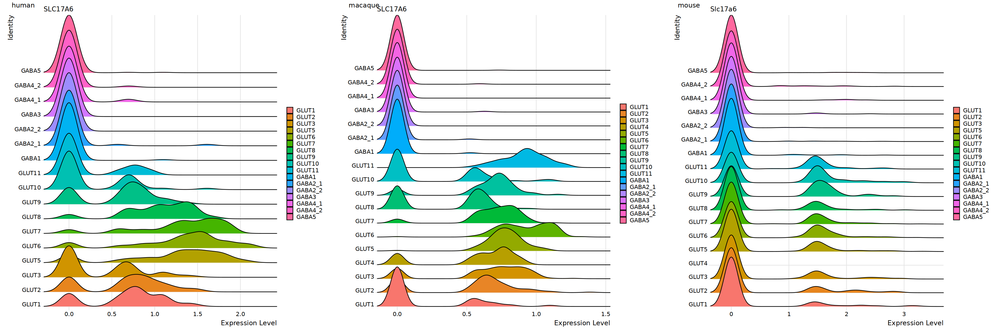

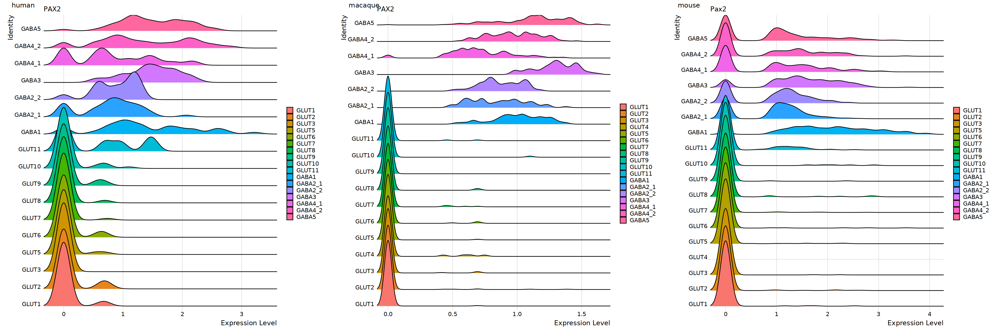

In [10]:
### sanity check. Glutamate transporter
options(repr.plot.width=30, repr.plot.height=10)

features = 'SLC17A6'
mouse_features = as.character(HgtoMm[features])
for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# inh marker
features = 'PAX2'
mouse_features = as.character(HgtoMm[features])
for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}


# GLUT1:BNC2 and HMGA2, formerly PDE3A

Picking joint bandwidth of 0.11

Picking joint bandwidth of 0.0154

Picking joint bandwidth of 0.0367

Picking joint bandwidth of 0.0591

Picking joint bandwidth of 0.0148

Picking joint bandwidth of 0.047

Picking joint bandwidth of 0.143

Picking joint bandwidth of 0.039

Picking joint bandwidth of 0.116



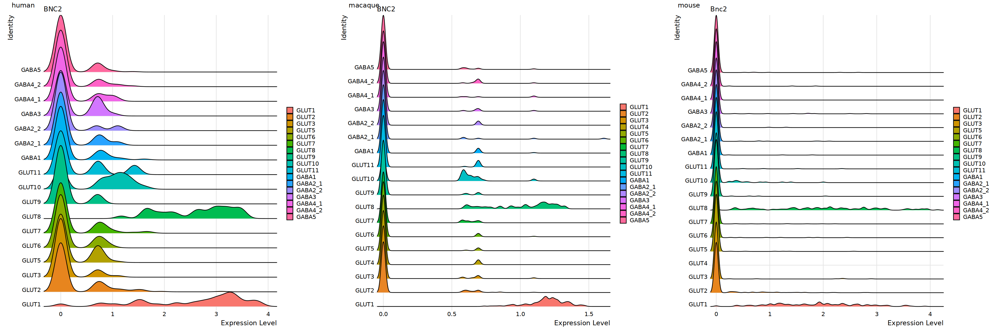

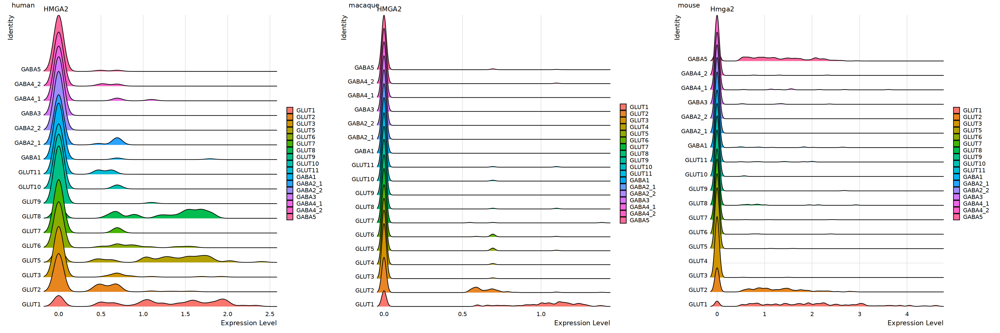

[1] "HMGA2"


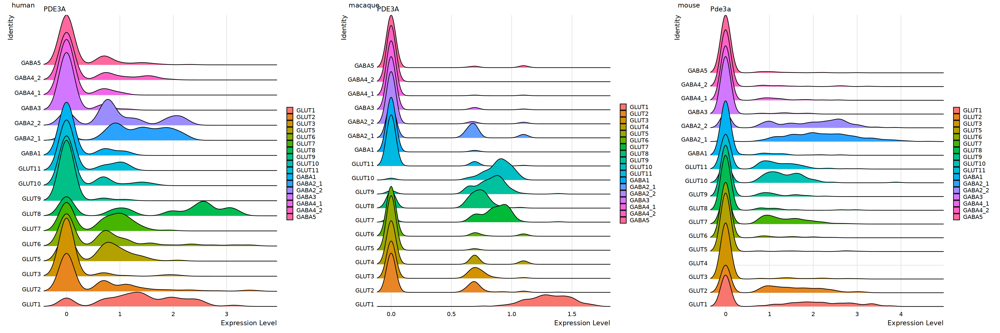

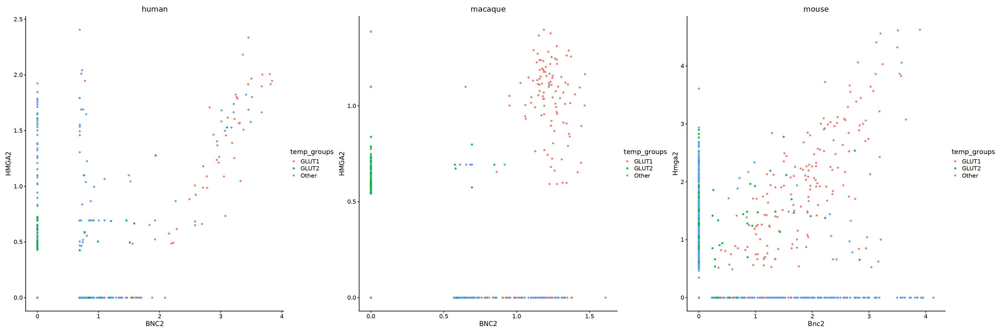

In [16]:
# GLUT1: cross-species name selection

features = c('BNC2','HMGA2','PDE3A')
mouse_features = as.character(HgtoMm[features])
for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

#### chosen cross-species markers for GLUT1
focus = 'GLUT1'
feature1 = 'BNC2'
features = c('HMGA2')#c('PDE3A') # this is done, 


opponent = 'GLUT2'

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# GLUT1: FBN2 and ADAM12 might be helpful for mouse
# Note: RELN is not a very good glut1/2 marker for macaque!!!

features = c('PDE11A','FBN2', 'ADAM12', 'RELN')
mouse_features = as.character(HgtoMm[features])
for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

In [ ]:
# GLUT1: looks like these two are best for macaque not others

features = c('CRHR2','COL13A1')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

In [ ]:
# GLUT1: more from stringent cross-species label transfer

features = c('GABRG3','HMGA2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GLUT2: NMUR2 and PREX2

Picking joint bandwidth of 0.0422

Picking joint bandwidth of 0.00292

Picking joint bandwidth of 0.0133

Picking joint bandwidth of 0.214

Picking joint bandwidth of 0.0167

Picking joint bandwidth of 0.048



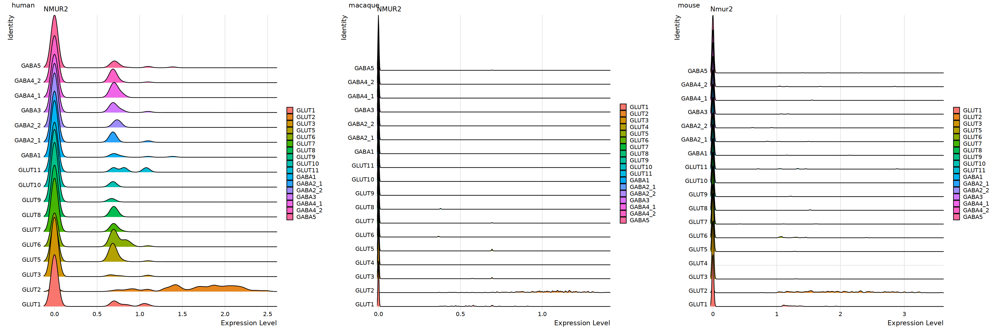

[1] "PREX2"


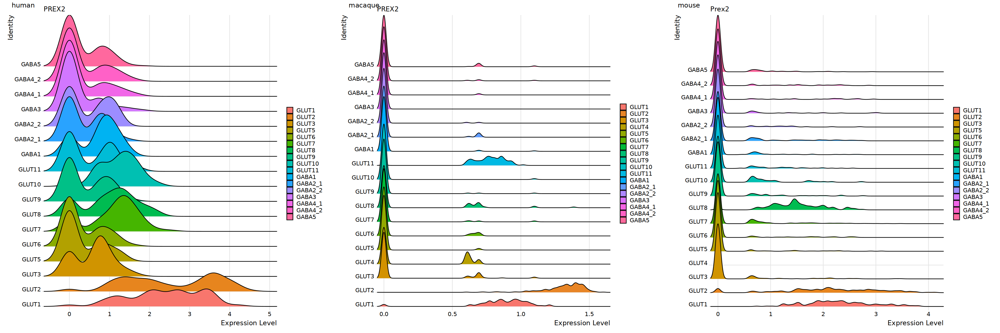

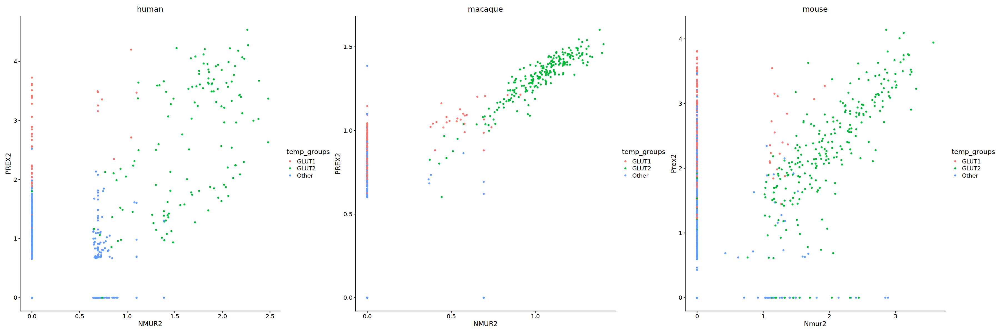

In [19]:
# GLUT2: chosen are NMUR2 and PREX2

focus = 'GLUT2'

features = c('NMUR2','PREX2')
mouse_features = as.character(HgtoMm[features])
for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatterplot
feature1 = 'NMUR2'
features = c('PREX2')#, ,'CHST9')

opponent = 'GLUT1'

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(mac)
    #print(mouse)
}

# GLUT3: NMU and TAC3

Picking joint bandwidth of 0.0121

Picking joint bandwidth of 0.0116

Picking joint bandwidth of 0.0166

Picking joint bandwidth of 0.0195

Picking joint bandwidth of 0.0194

Picking joint bandwidth of 0.0168



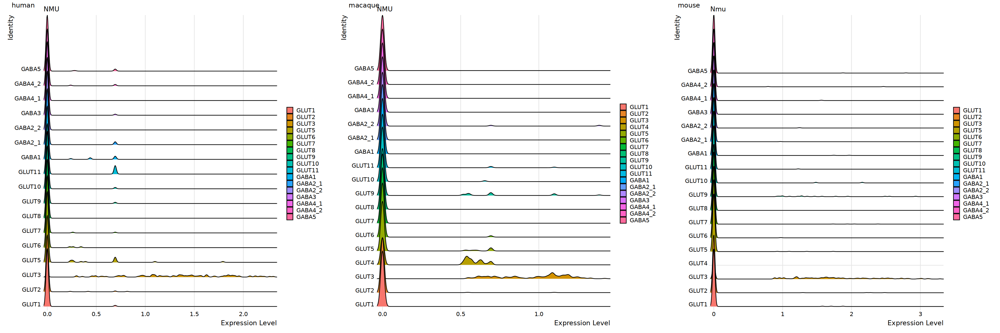

[1] "TAC3"


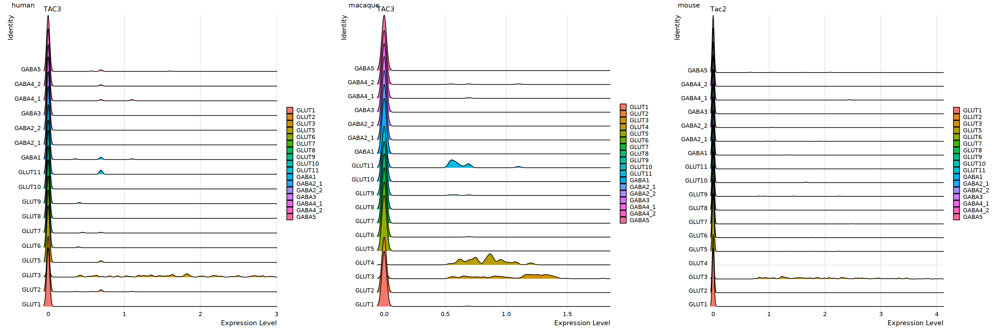

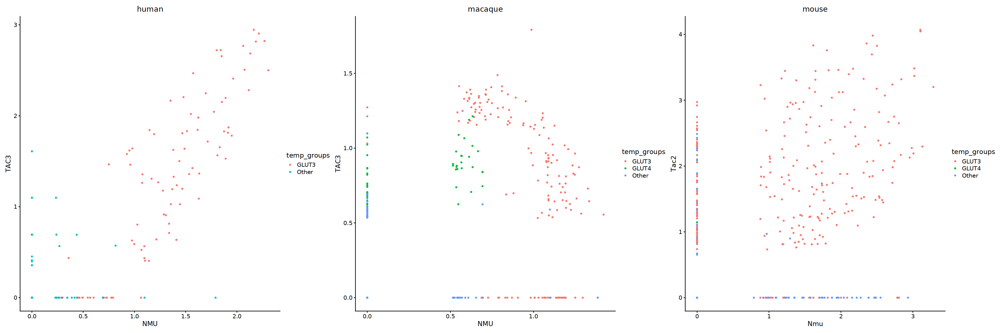

In [20]:
# GLUT3: chosen are 'NMU' and 'TAC3'. TRPM3 is not actually very good
focus = 'GLUT3'
features = c('NMU','TAC3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}


## scatter
focus = 'GLUT3'
opponent = 'GLUT4'
feature1 = 'NMU'
features = c('TAC3')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
## GLUT3: more examples

features = c('MAML3', 'TSHZ3','TRPM3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

In [ ]:
### just nmu, each species

focus = 'GLUT3'
feature = 'NMU'
mouse_feature = as.character(HgtoMm[feature])

h = RidgePlot(human_rna_dh, features = feature, idents = c('GLUT1','GLUT2', 'GLUT3', 'GLUT4'))
mac = RidgePlot(macaque_rna_dh, features = feature, idents = c('GLUT1','GLUT2', 'GLUT3', 'GLUT4'))
mouse = RidgePlot(mouse_rna, features = mouse_feature, idents = c('GLUT1','GLUT2', 'GLUT3', 'GLUT4'))

print(h)
print(mac)
print(mouse)

In [ ]:
# macaque is also hard to separate from GLUT3 anyways. Re-visit GLUT4

focus = 'GLUT4'
feature1 = 'TTC39C'
features = c('RASGRF2', 'PLCB4') #

opponent = 'GLUT3'

for (ii in 1:length(features)){
    feature2 = features[ii]
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
}

# GLUT4: Exc-TAC3/COL5A2/PLCH1 doesn't label human or mouse

Picking joint bandwidth of 0.0249

Picking joint bandwidth of 0.058



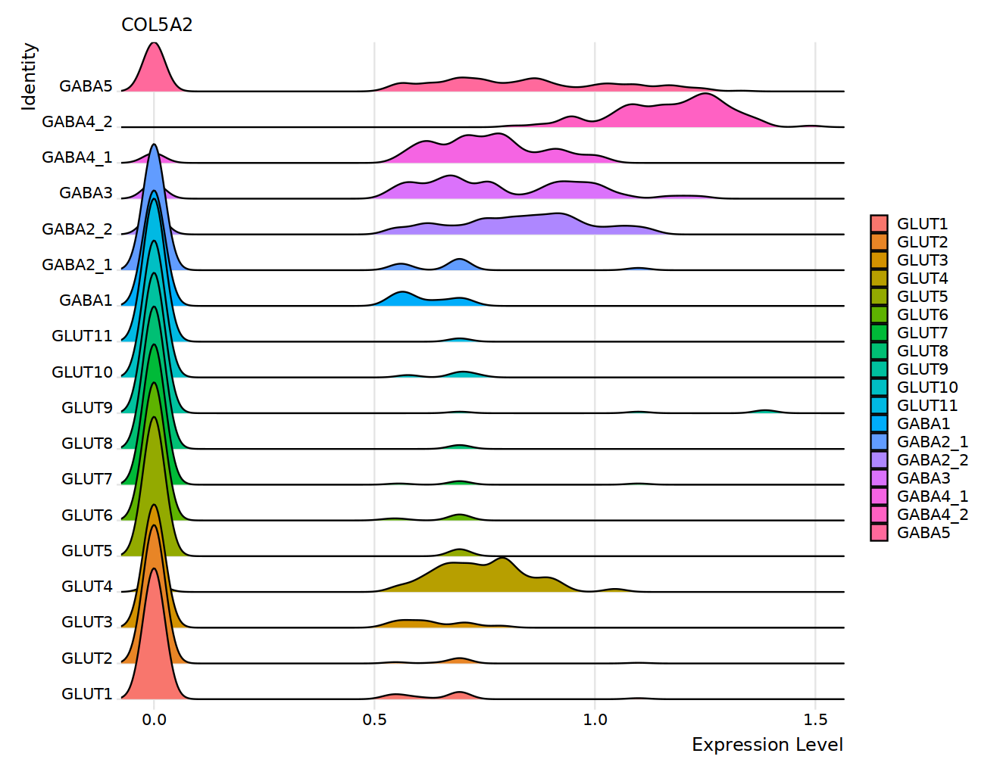

Picking joint bandwidth of 0.0781



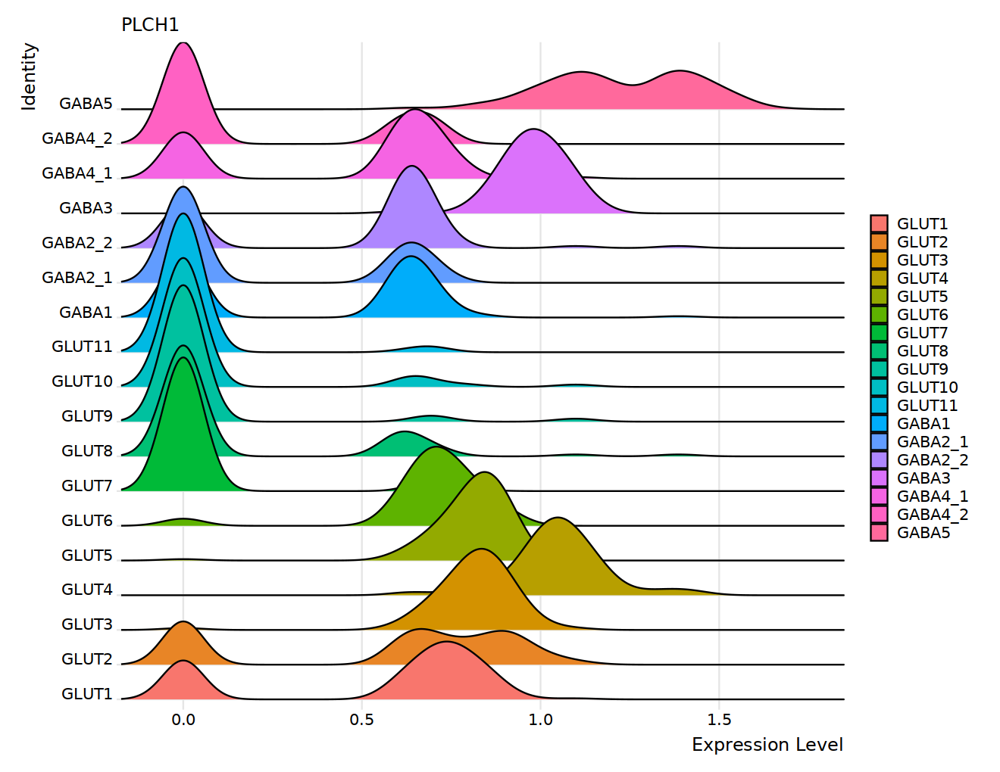

Picking joint bandwidth of 0.0194



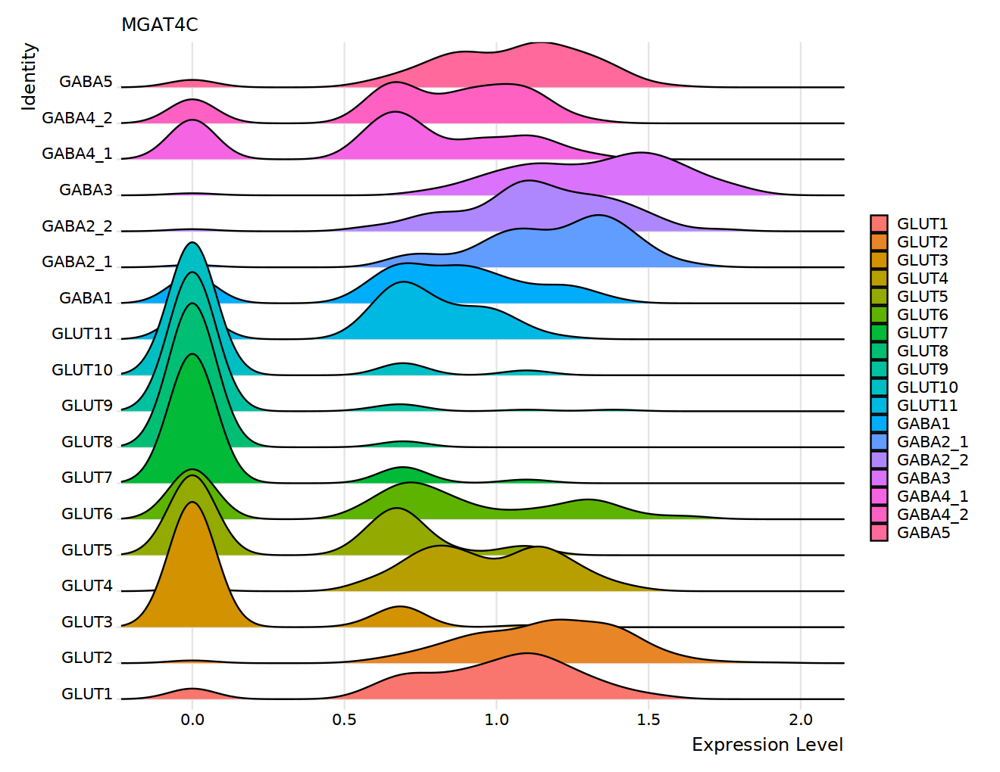

[1] "TAC3"


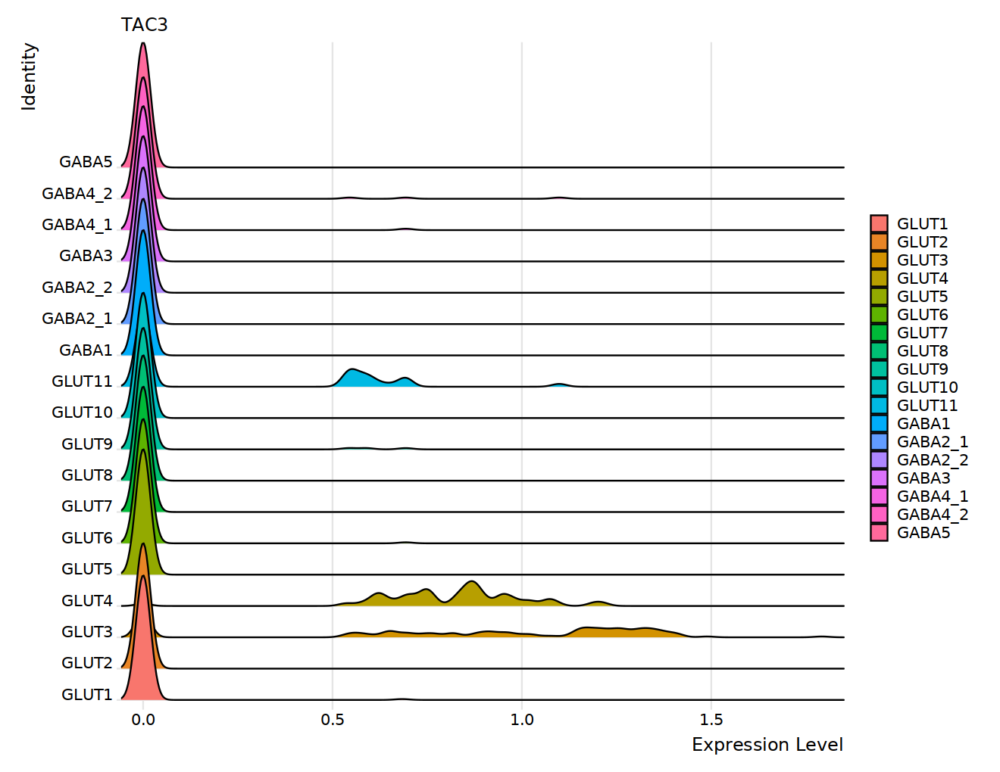

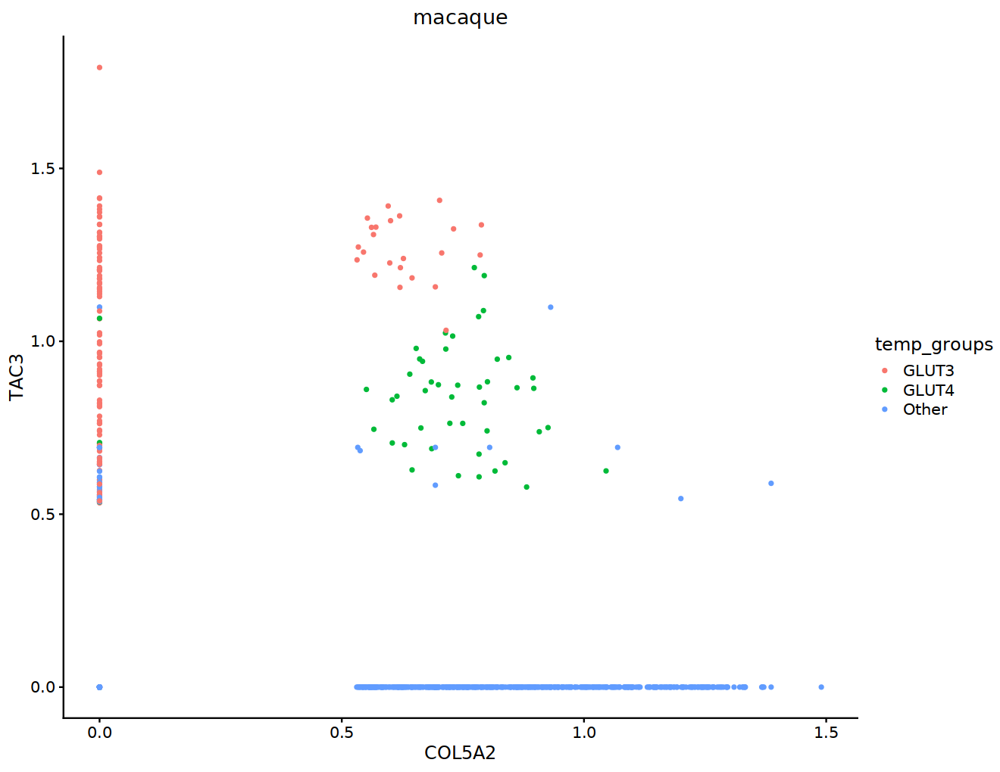

In [18]:

focus = 'GLUT4'
features = c('COL5A2','PLCH1','MGAT4C', 'TAC3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    mac = RidgePlot(macaque_rna_dh, features = feature)
    print(mac)

}


## scatter
focus = 'GLUT4'
opponent = 'GLUT3'
feature1 = 'COL5A2'
features = c('TAC3')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    print(mac)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

# GLUT5: LMO3 and TRPC3. PDE1C also good. TRPC3 > macaque, PDE1C > mouse

Picking joint bandwidth of 0.0427

Picking joint bandwidth of 0.00509

Picking joint bandwidth of 0.0443

Picking joint bandwidth of 0.091

Picking joint bandwidth of 0.0223

Picking joint bandwidth of 0.0372

Picking joint bandwidth of 0.217

Picking joint bandwidth of 0.061

Picking joint bandwidth of 0.12



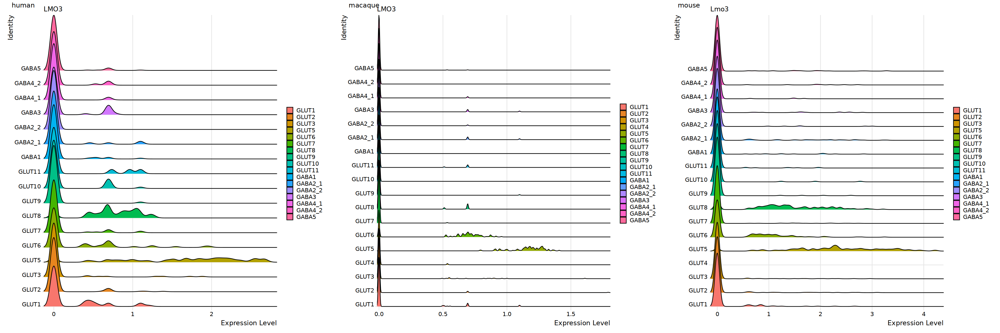

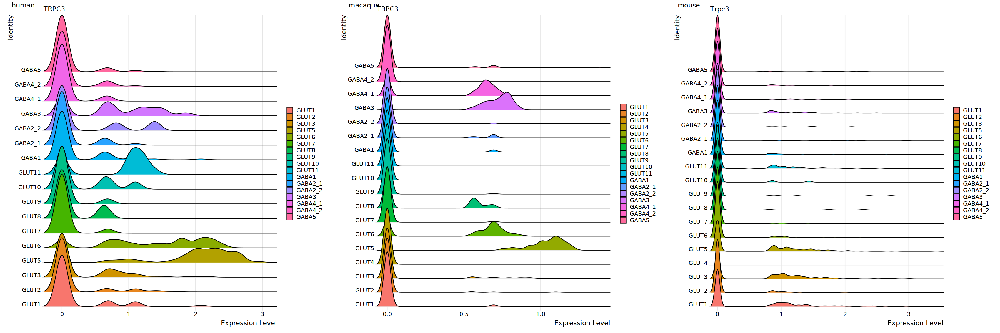

[1] "TRPC3"


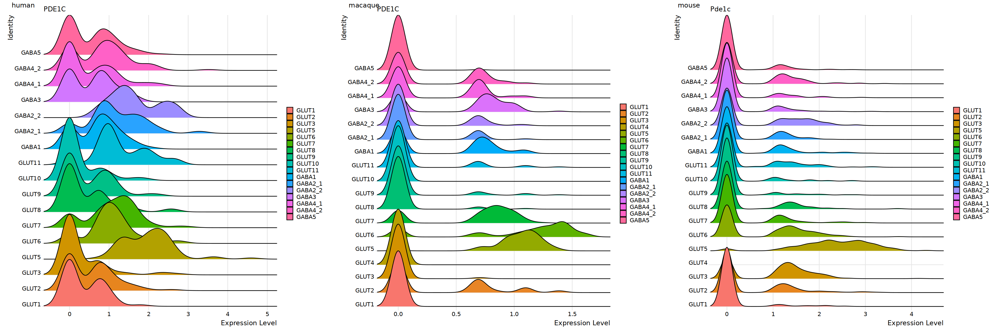

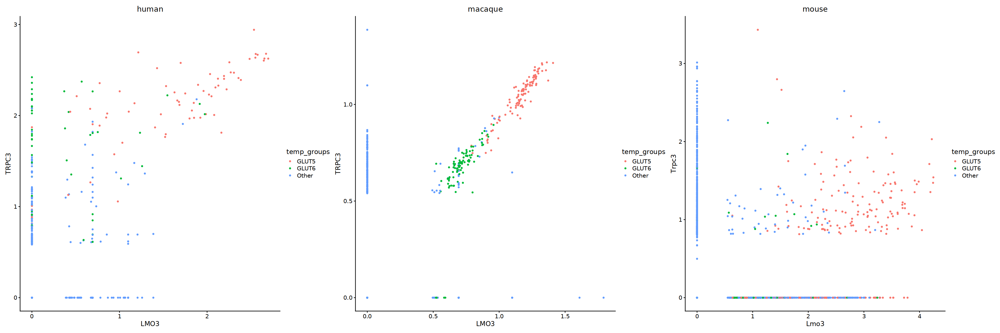

In [17]:
# GLUT5: LMO3 and TRPC3
features = c('LMO3', 'TRPC3', "PDE1C")
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT5'
opponent = 'GLUT6'
feature1 = 'LMO3'
features = c('TRPC3')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# GLUT5: More

features = c('KCND3','KCTD8','OTOF','PCDH15','PDE1C','TAC1', 'GALNTL6','PCDH15')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GLUT6: SKOR2 and NELL2

Picking joint bandwidth of 0.0732

Picking joint bandwidth of 0.027

Picking joint bandwidth of 0.041

Picking joint bandwidth of 0.193

Picking joint bandwidth of 0.0883

Picking joint bandwidth of 0.0807



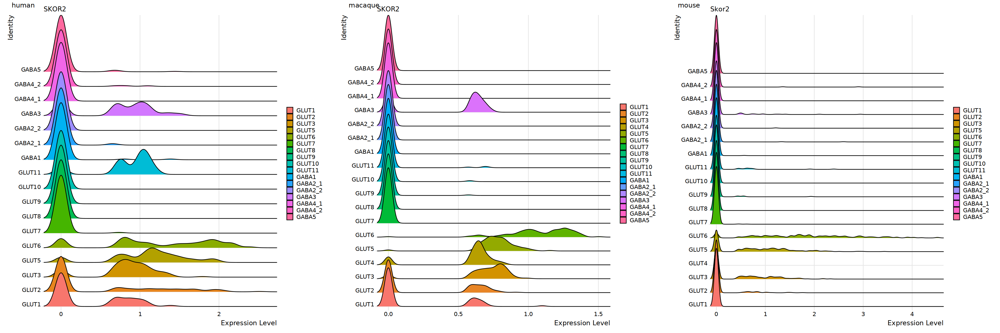

[1] "NELL2"


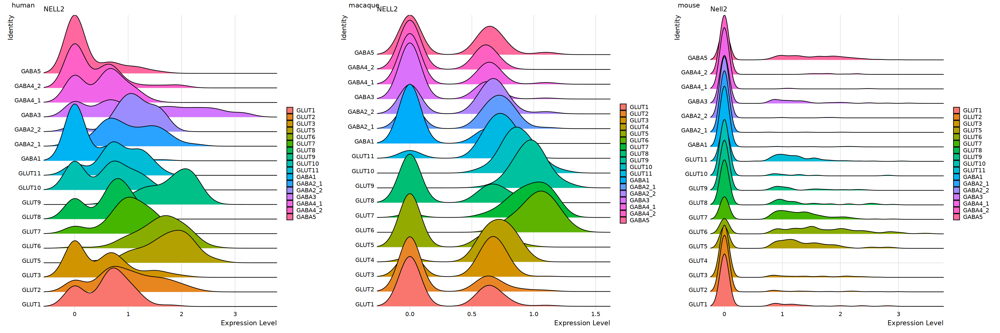

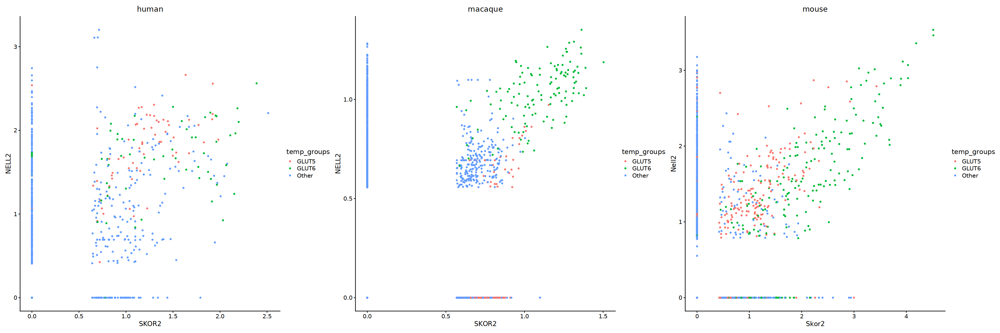

In [21]:
# GLUT6: 'SKOR2', 'NELL2'

features = c('SKOR2', 'NELL2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT6'
opponent = 'GLUT5'
feature1 = 'SKOR2'
features = c('NELL2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# GLUT6: Other examples. DCC isn't as good a choice, see human

features = c('DCC', 'PRSS12',,'GPR149','SPHKAP','ARHGAP24','ALK','COL5A2','TACR1','TMCC3','GALNTL6','PCDH15')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT6'
opponent = 'GLUT5'
feature1 = 'SKOR2'
features = c('NELL2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

# GLUT7: MAF and ADARB2. CDH22 also good and pretty similar

Picking joint bandwidth of 0.0436

Picking joint bandwidth of 0.0227

Picking joint bandwidth of 0.0466

Picking joint bandwidth of 0.221

Picking joint bandwidth of 0.0794

Picking joint bandwidth of 0.247

Picking joint bandwidth of 0.124

Picking joint bandwidth of 0.104

Picking joint bandwidth of 0.223



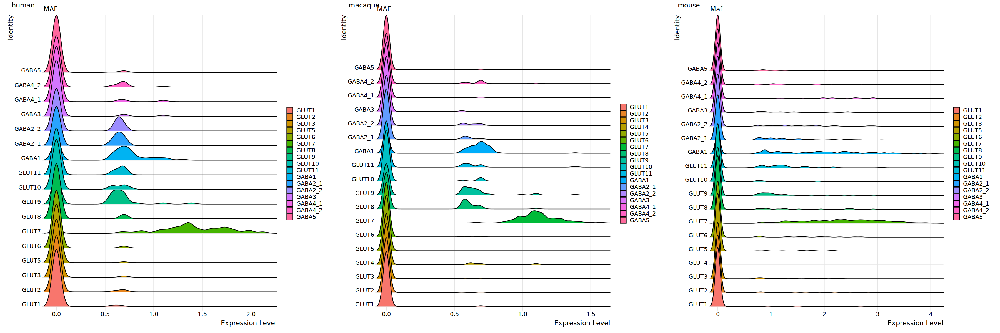

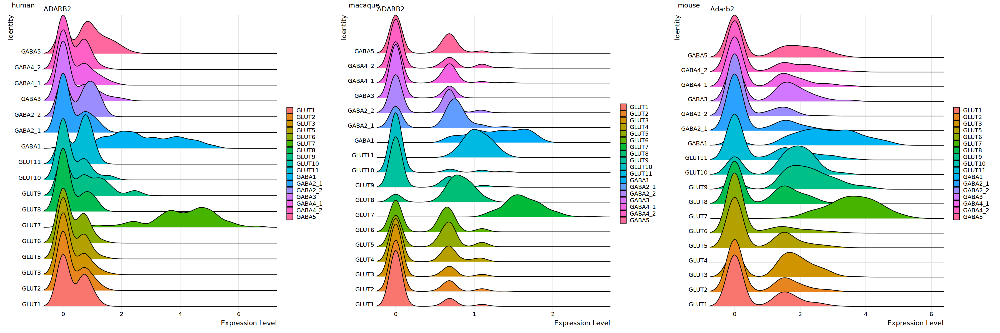

[1] "ADARB2"


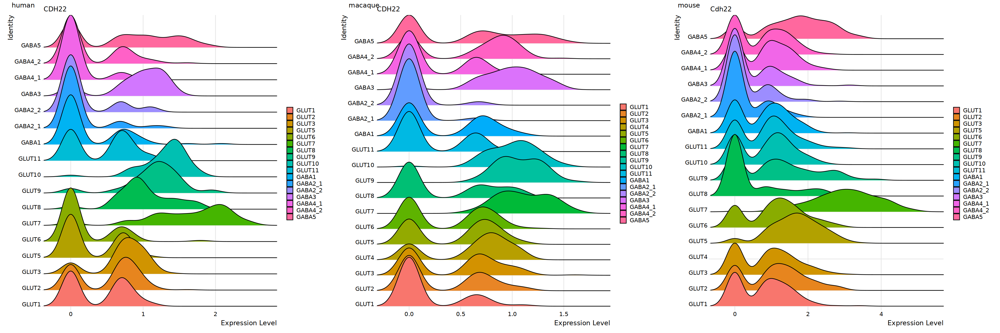

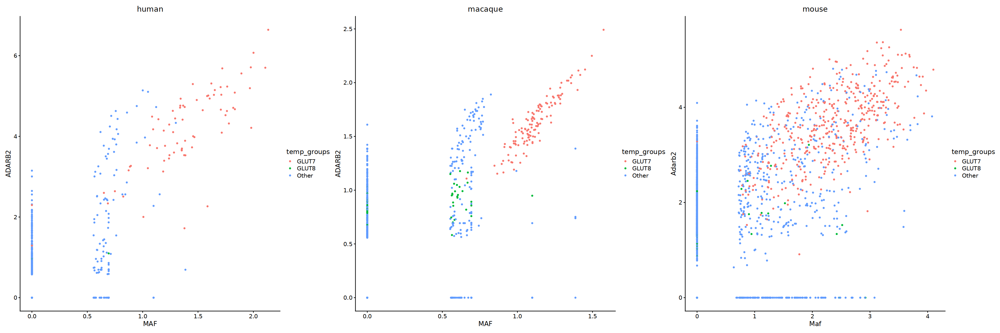

In [22]:
# GLUT7: MAF and ADARB2
options(repr.plot.width=30, repr.plot.height=10)
features = c('MAF','ADARB2', 'CDH22')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT7'
opponent = 'GLUT8'
feature1 = 'MAF'
features = c('ADARB2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# GLUT7: more examples
features = c('PDZRN3','COL27A1', 'CCK')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GLUT8: MAFA and BNC2. CHGB and CPNE4 pretty good

Picking joint bandwidth of 0.192

Picking joint bandwidth of 0.0829

Picking joint bandwidth of 0.0555

Picking joint bandwidth of 0.0265

Picking joint bandwidth of 0.0102

Picking joint bandwidth of 0.00422

Picking joint bandwidth of 0.202

Picking joint bandwidth of 0.101

Picking joint bandwidth of 0.196



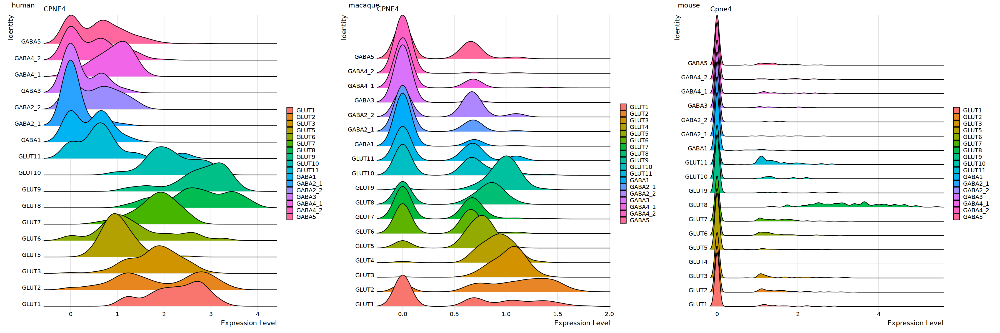

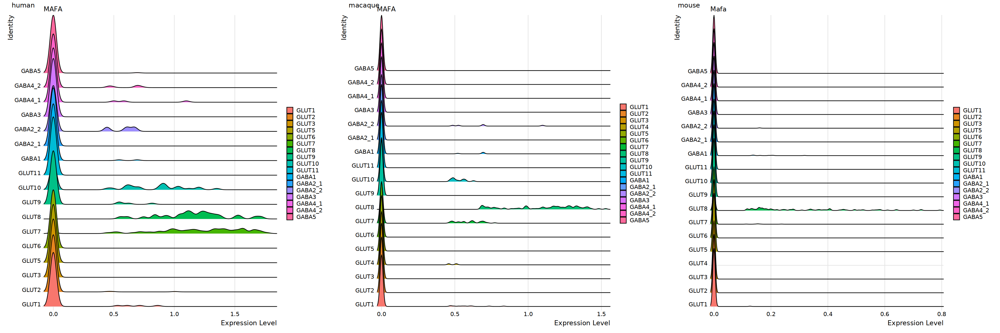

[1] "BNC2"


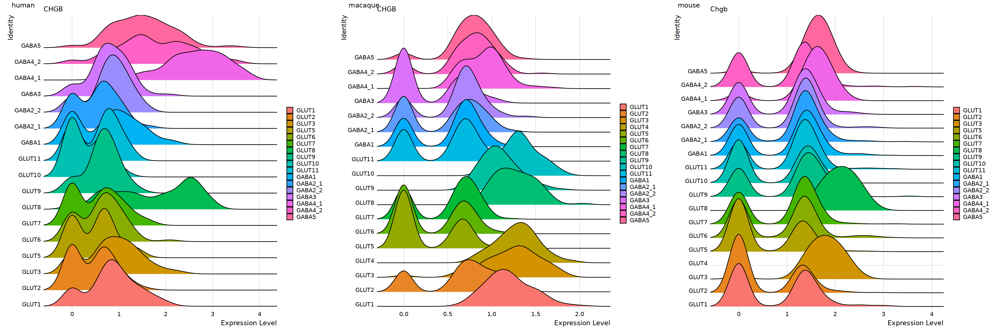

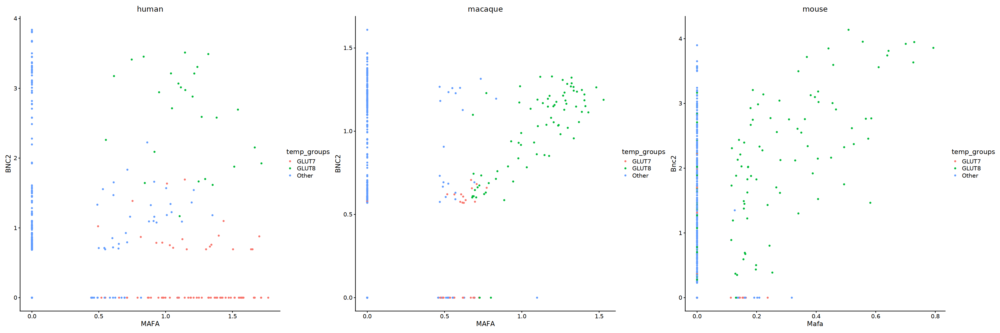

In [23]:
### GLUT8: MAFA and CPNE4
features = c('CPNE4','MAFA','CHGB')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT8'
opponent = 'GLUT7'
feature1 = 'MAFA'
features = c('BNC2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
#GLUT8: More examples

features = c('ERBB4','DACH2','ST8SIA6')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GLUT9: NTS and TSHZ2 (eh, but consistently most expressed in GLUT9 across species)

Picking joint bandwidth of 0.0261

Picking joint bandwidth of 0.0147

Picking joint bandwidth of 0.0469

Picking joint bandwidth of 0.32

Picking joint bandwidth of 0.0914

Picking joint bandwidth of 0.256



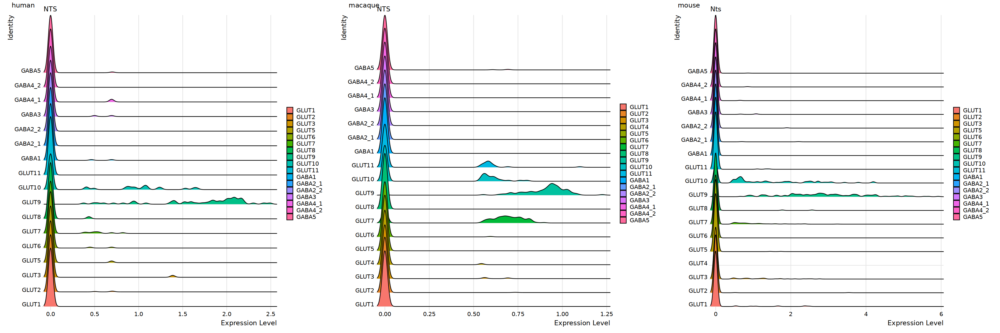

[1] "TSHZ2"


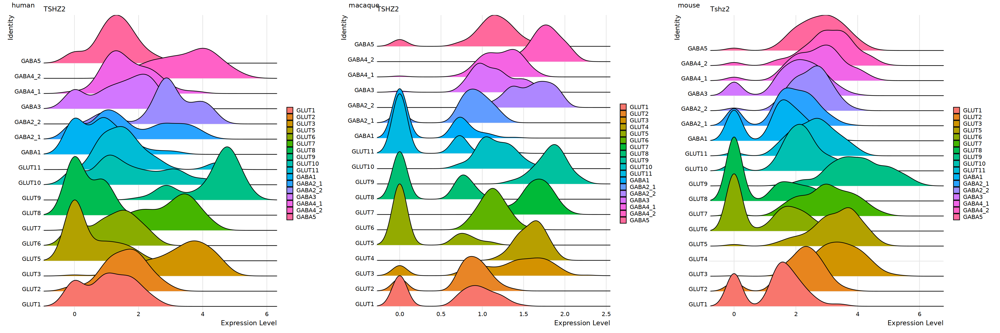

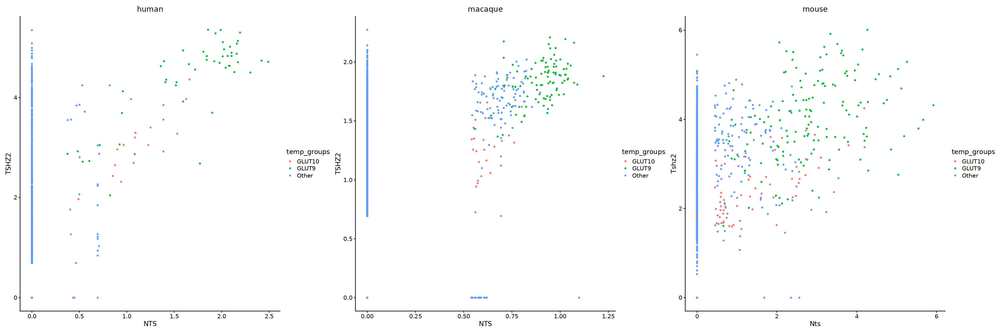

In [24]:
### GLUT9: 'NTS','TSHZ2'
features = c('NTS','TSHZ2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT9'
opponent = 'GLUT10'
feature1 = 'NTS'
features = c('TSHZ2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}


In [ ]:
# GLUT9: More examples
features = c('GPHN','UNC5D','SYNPR')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GLUT10: SNTB1, DACH1, TRH

Picking joint bandwidth of 0.219

Picking joint bandwidth of 0.0809

Picking joint bandwidth of 0.182

Picking joint bandwidth of 0.101

Picking joint bandwidth of 0.0451

Picking joint bandwidth of 0.0866

Picking joint bandwidth of 0.151

Picking joint bandwidth of 0.0534

Picking joint bandwidth of 0.175



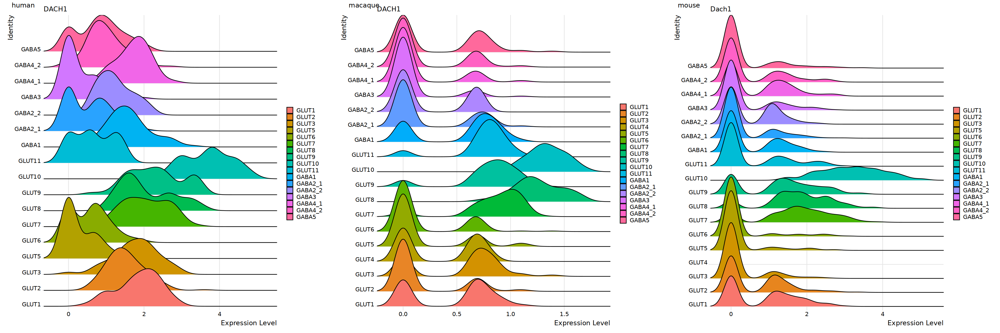

Picking joint bandwidth of 0.0358

Picking joint bandwidth of 0.0123

Picking joint bandwidth of 0.0187



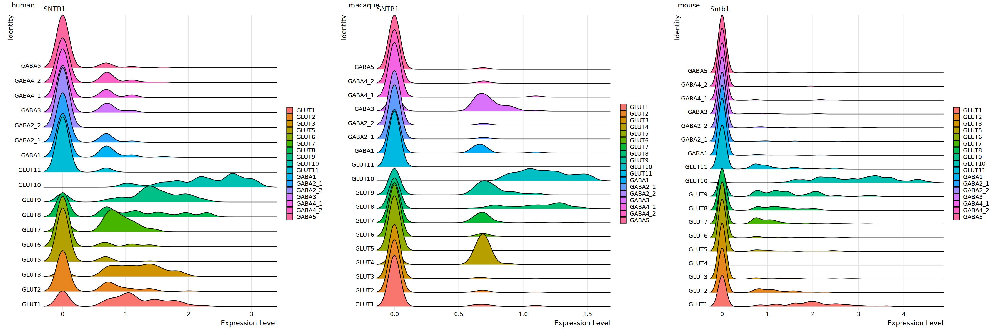

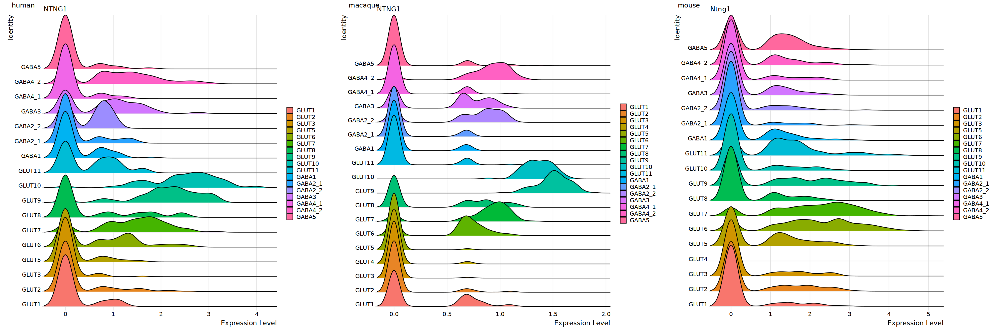

[1] "NTNG1"


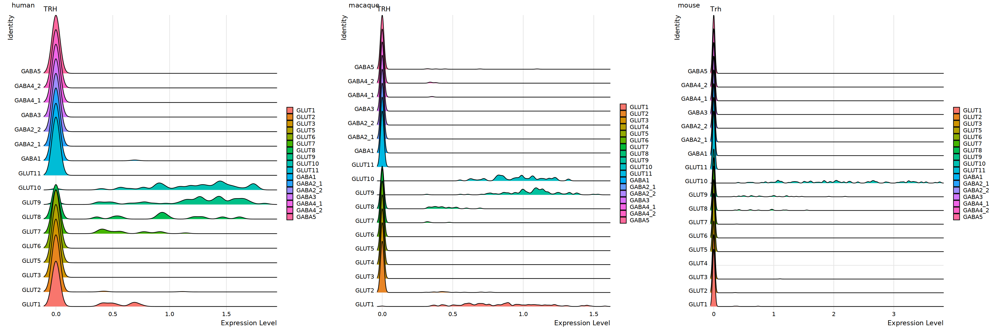

[1] "DACH1"


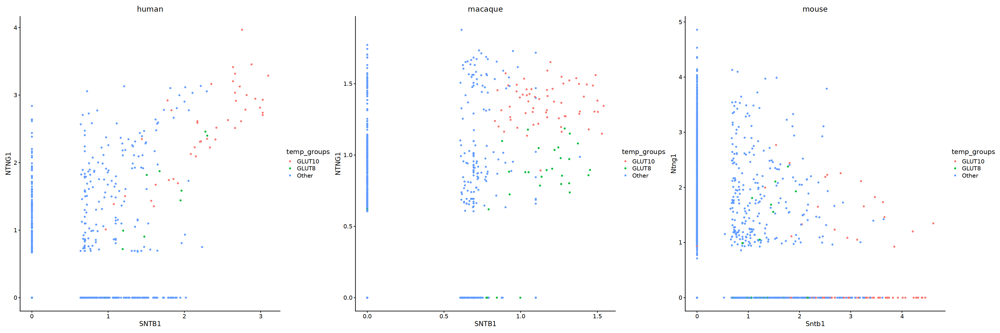

[1] "TRH"


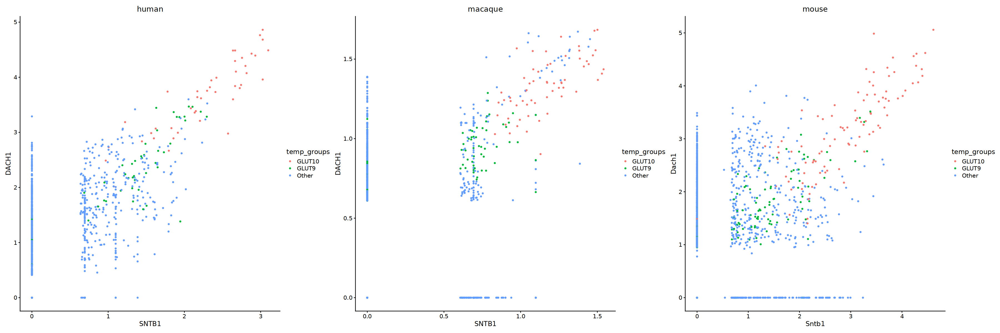

[1] "TRH"


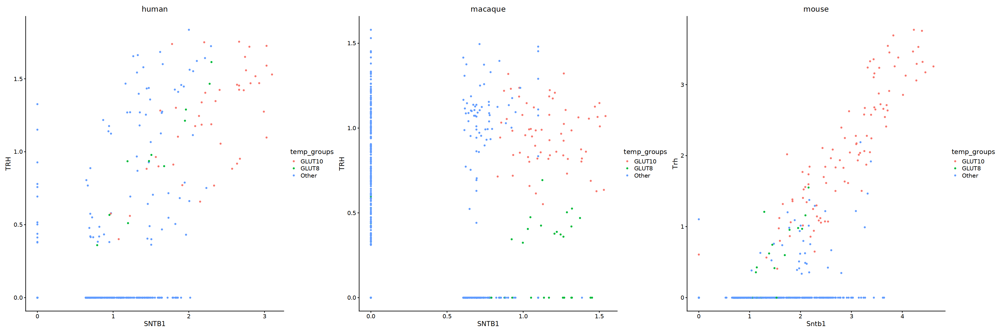

[1] "TRH"


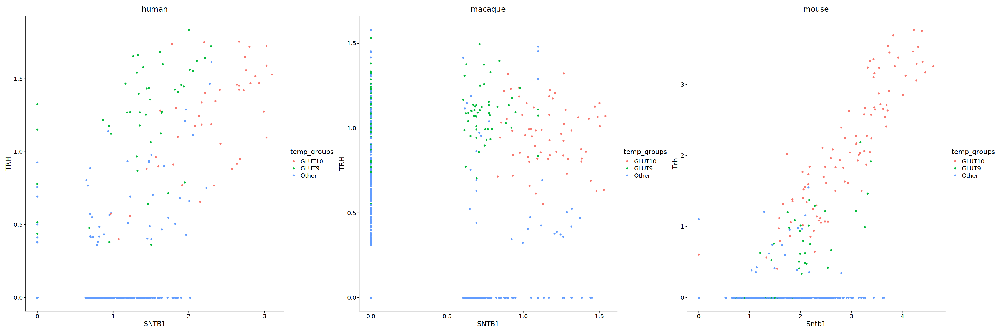

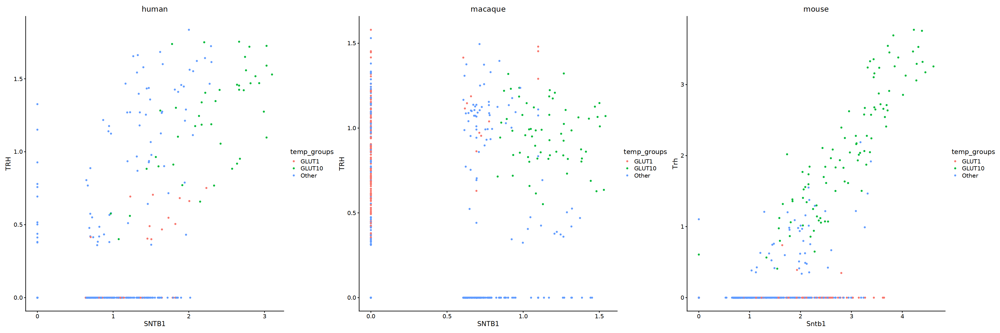

In [12]:
## GLUT10: SNTB1 and DACH1
options(repr.plot.width=30, repr.plot.height=10)
focus = 'GLUT10'
features = c('DACH1','SNTB1', 'NTNG1', 'TRH') #

mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT10'
opponent = 'GLUT8'
feature1 = 'SNTB1'
features = c('NTNG1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GLUT10'
opponent = 'GLUT9'
feature1 = 'SNTB1'
features = c('DACH1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GLUT10'
opponent = 'GLUT8'
feature1 = 'SNTB1'
features = c('TRH')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GLUT10'
opponent = 'GLUT9'
feature1 = 'SNTB1'
features = c('TRH')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GLUT10'
opponent = 'GLUT1'
feature1 = 'SNTB1'
features = c('TRH')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
#GLUT10: more

focus = 'GLUT10'
features = c('TEX15','NR2F1','GPHN', 'PRKCG','CPNE8') #

mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

In [ ]:
## also missing labels for human

focus = 'GLUT11'
feature1 = 'PROX1'
features = c('RREB1', 'KIAA1217') #

for (ii in 1:length(features)){
    feature2 = features[ii]
    print('feature2')
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
}

# GLUT11: PBX3 and SLIT2

Picking joint bandwidth of 0.173

Picking joint bandwidth of 0.0402

Picking joint bandwidth of 0.112

Picking joint bandwidth of 0.174

Picking joint bandwidth of 0.0373

Picking joint bandwidth of 0.217



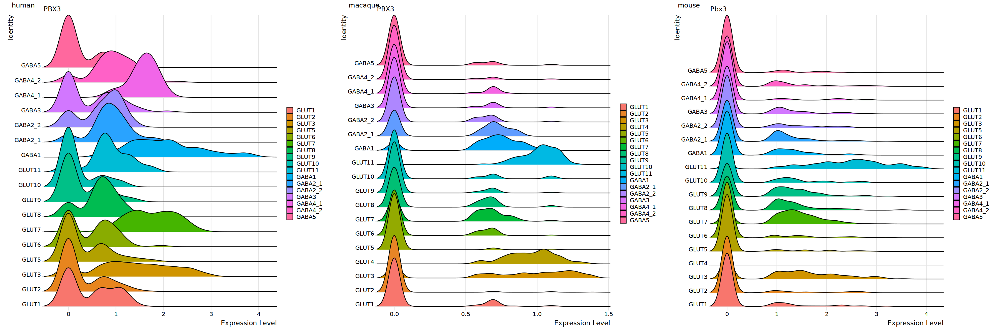

[1] "SLIT2"


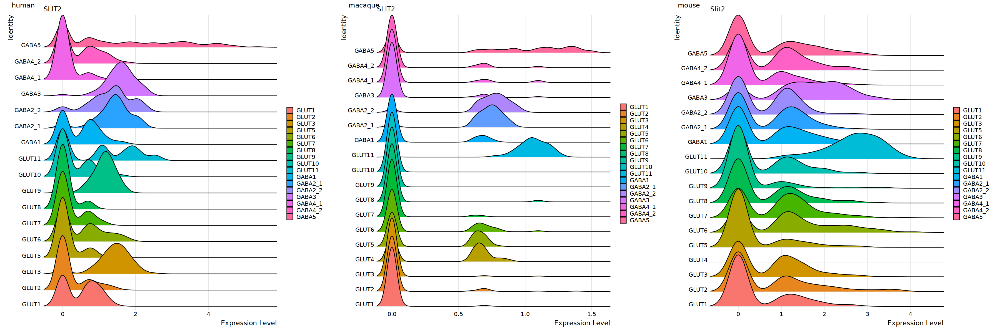

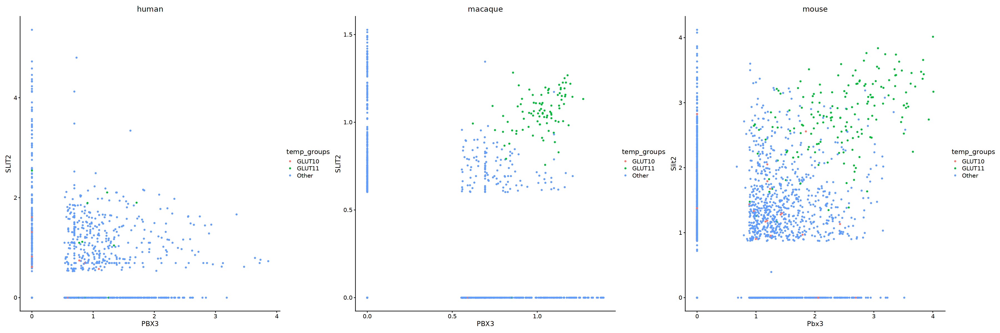

In [27]:

features = c('PBX3','SLIT2')#,'TACR1','VWC2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GLUT11'
opponent = 'GLUT10'
feature1 = 'PBX3'
features = c('SLIT2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    
}

# GABA1: CACNA2D3 and TCF4. GRM3 seems not as good actually

Picking joint bandwidth of 0.237

Picking joint bandwidth of 0.0844

Picking joint bandwidth of 0.208

Picking joint bandwidth of 0.158

Picking joint bandwidth of 0.0609

Picking joint bandwidth of 0.244

Picking joint bandwidth of 0.216

Picking joint bandwidth of 0.0726

Picking joint bandwidth of 0.254



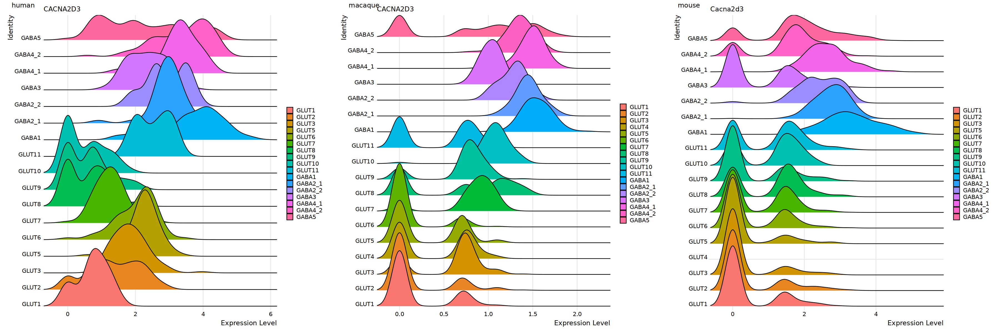

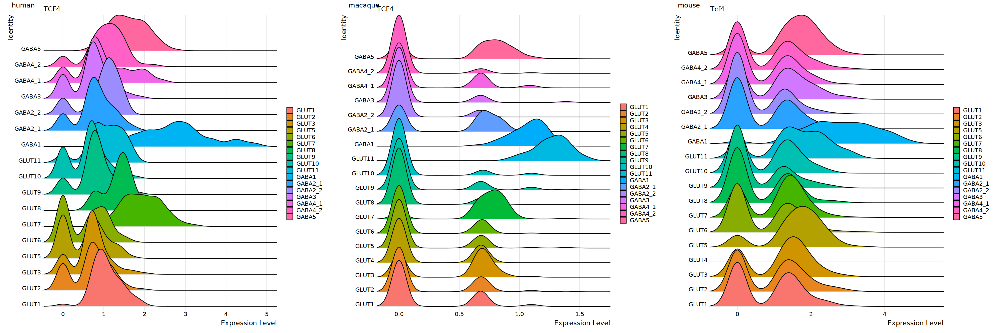

[1] "CACNA2D3"


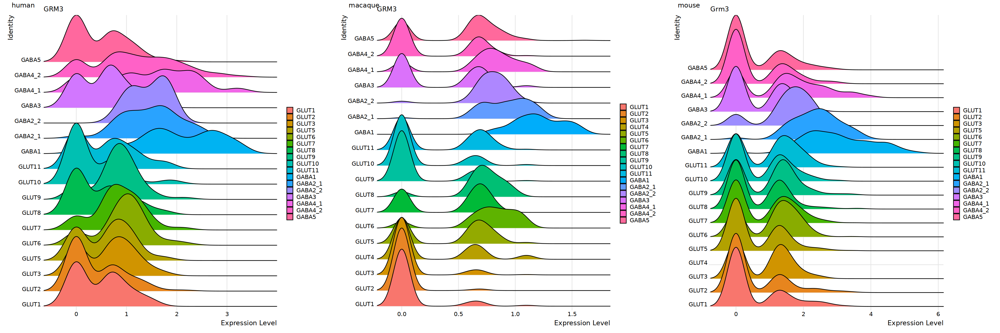

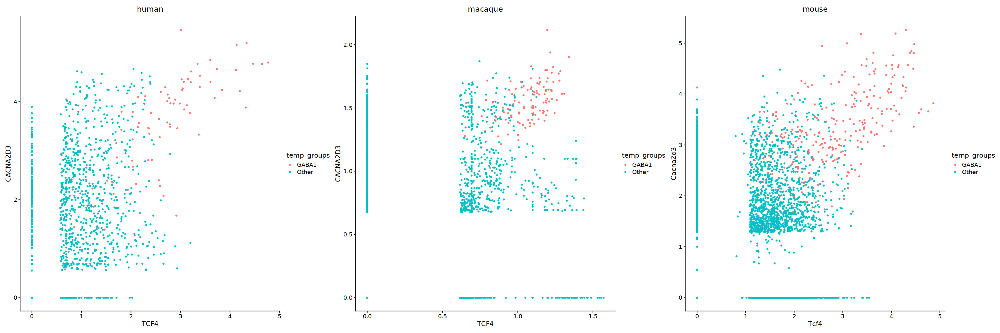

In [28]:
# GABA1
features = c('CACNA2D3','TCF4', 'GRM3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA1'
feature1 = 'TCF4'
features = c('CACNA2D3')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# Try ADARB2 with CDH3 or CDHR3 for GABA1
# GABA1: more examples
features = c('ADARB2','CDH3','CDHR3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA1'
feature1 = 'CDH3'
features = c('ADARB2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# GABA1: more examples
features = c('HCN1','TCF4','ZNF385B','LRRC4C','MITF','GPC5','ZMAT4', 'PVALB')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}



# GABA2_1: SORCS1 and SDK1

Picking joint bandwidth of 0.211

Picking joint bandwidth of 0.0748

Picking joint bandwidth of 0.249

Picking joint bandwidth of 0.271

Picking joint bandwidth of 0.102

Picking joint bandwidth of 0.117



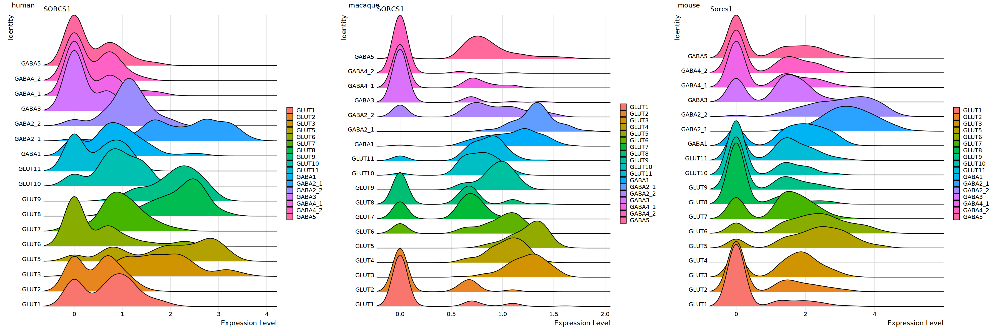

[1] "SDK1"


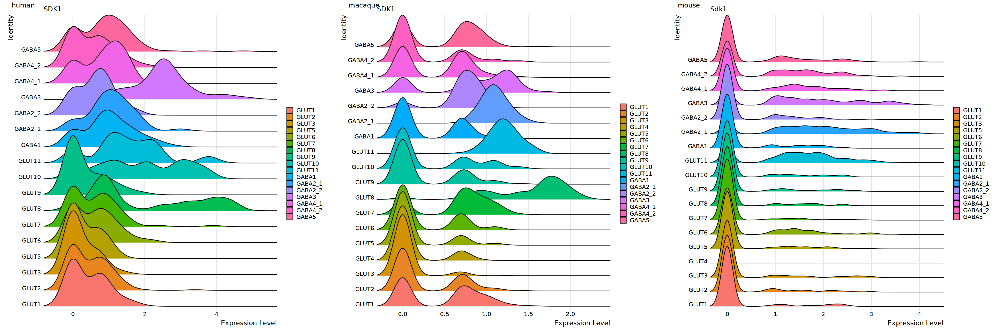

[1] "SDK1"


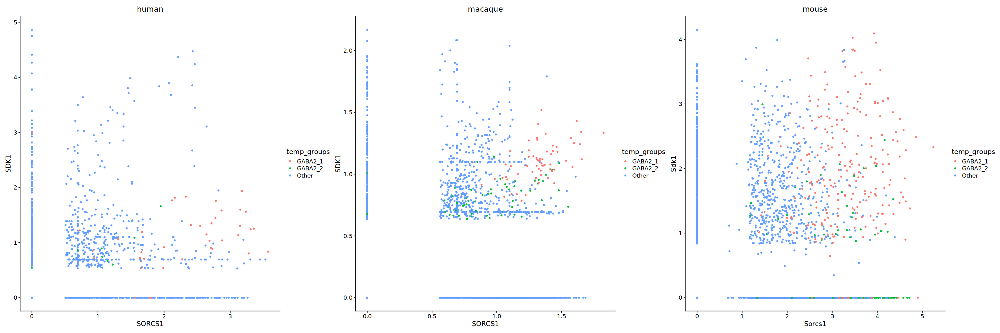

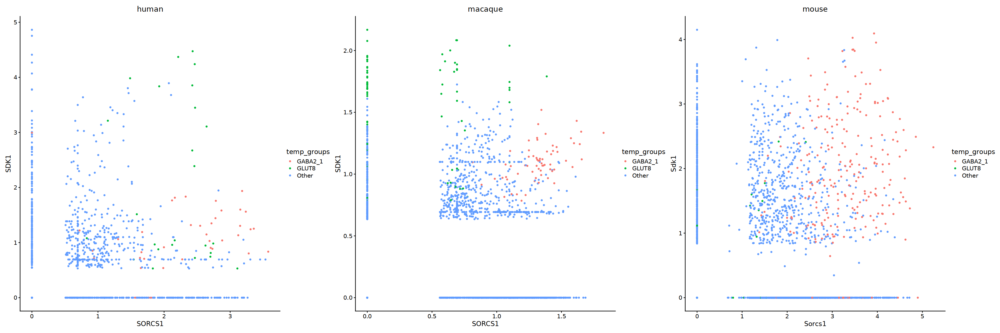

In [20]:
features = c('SORCS1','SDK1')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA2_1'
opponent = 'GABA2_2'
feature1 = 'SORCS1'
features = c('SDK1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GABA2_1'
opponent = 'GLUT8'
feature1 = 'SORCS1'
features = c('SDK1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
# More
features = c('CDH12','MGAT4C','RHBDL3', 'MGAT4C','SORCS3','SV2C')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GABA2_2: PDZD2 and SGCD. Try to find gene in only 2_2 and not 2_1.

Picking joint bandwidth of 0.196

Picking joint bandwidth of 0.0688

Picking joint bandwidth of 0.151

Picking joint bandwidth of 0.234

Picking joint bandwidth of 0.0934

Picking joint bandwidth of 0.342



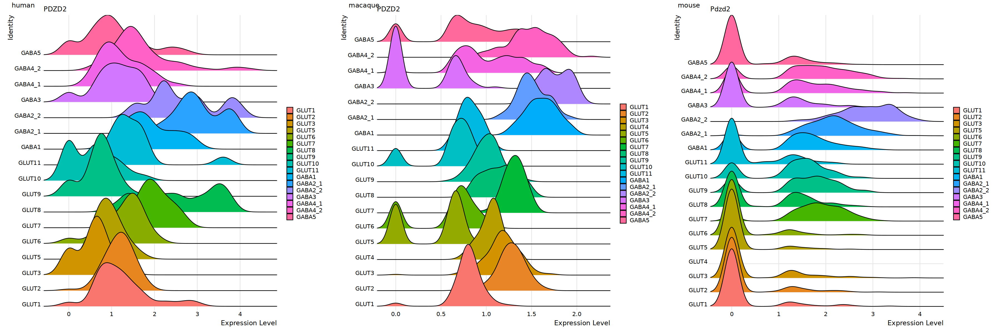

[1] "SGCD"


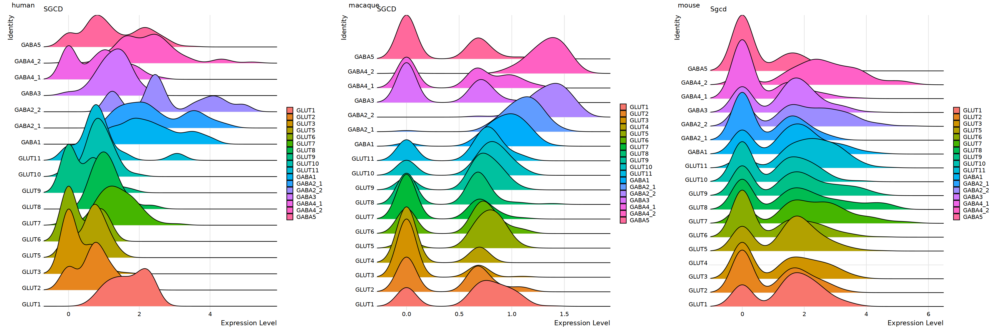

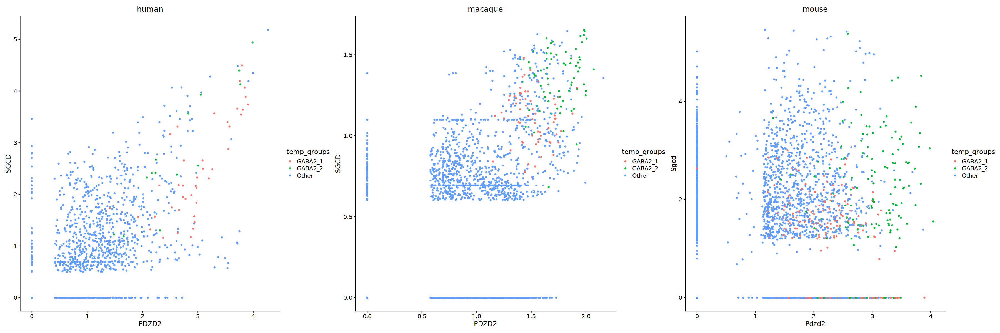

In [30]:
features = c('PDZD2','SGCD')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA2_2'
opponent = 'GABA2_1'
feature1 = 'PDZD2'
features = c('SGCD')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

In [ ]:
#more
features = c('CHRM3','DMD','GRIK2','PDE10A','ROBO1','RYR3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

# GABA3: NPY and ZIC1

Picking joint bandwidth of 0.0671

Picking joint bandwidth of 0.0168

Picking joint bandwidth of 0.0107

Picking joint bandwidth of 0.118

Picking joint bandwidth of 0.0226

Picking joint bandwidth of 0.0239

Picking joint bandwidth of 0.236

Picking joint bandwidth of 0.0824

Picking joint bandwidth of 0.211



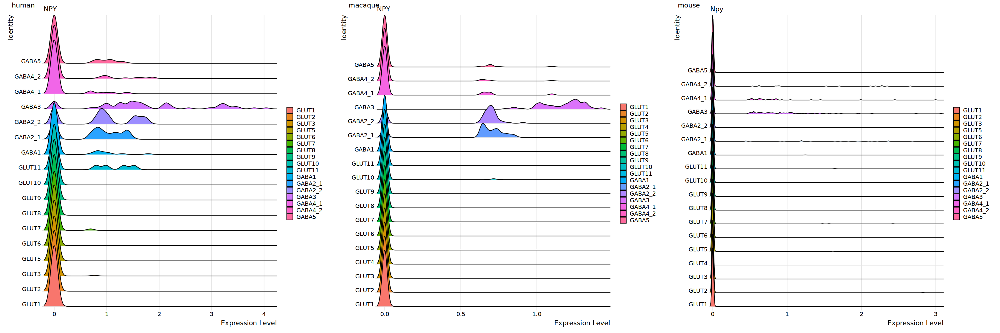

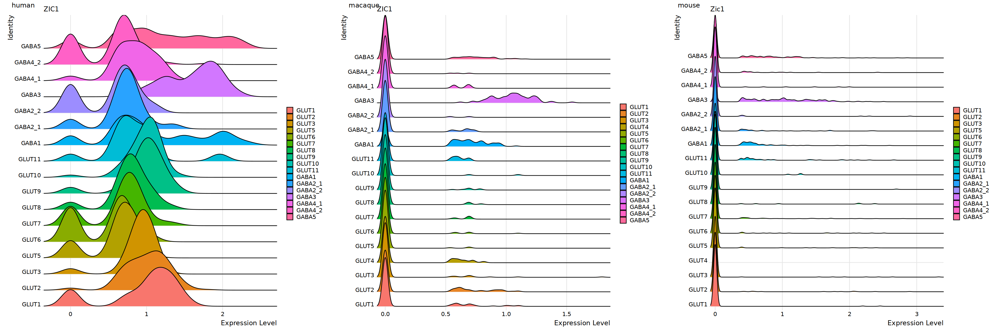

[1] "ZIC1"


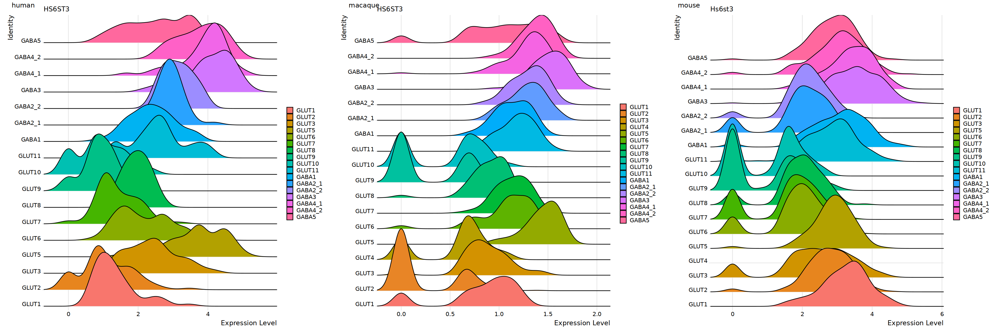

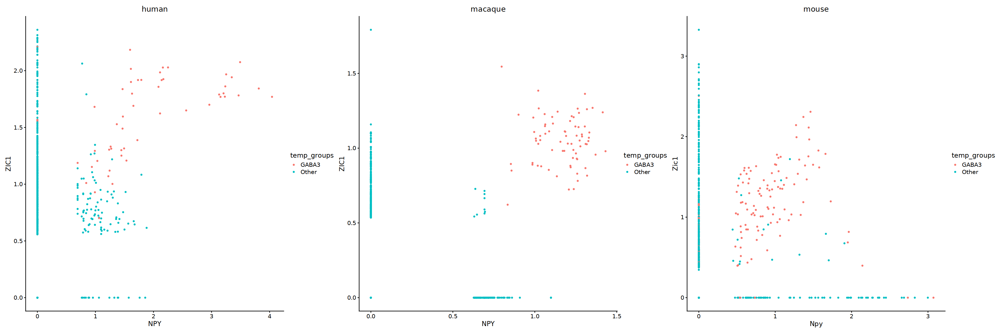

In [31]:
# GABA3: NPY and ZIC1

features = c('NPY','ZIC1', 'HS6ST3')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA3'
feature1 = 'NPY'
features = c('ZIC1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

# GABA4_1: MEF2C and RORB

Picking joint bandwidth of 0.193

Picking joint bandwidth of 0.115

Picking joint bandwidth of 0.179

Picking joint bandwidth of 0.123

Picking joint bandwidth of 0.0412

Picking joint bandwidth of 0.08



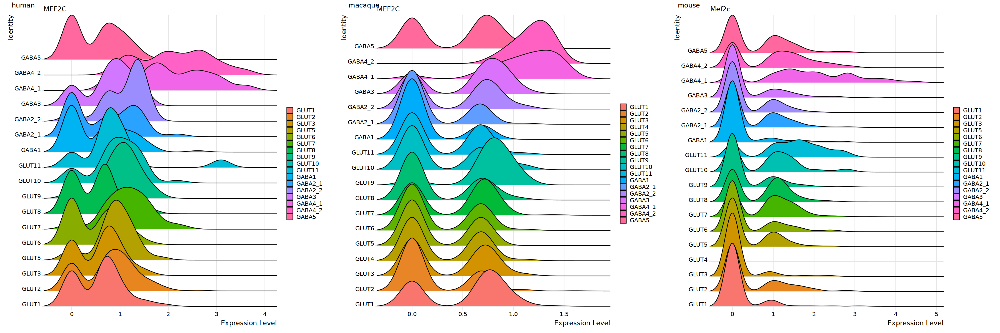

[1] "MEF2C"


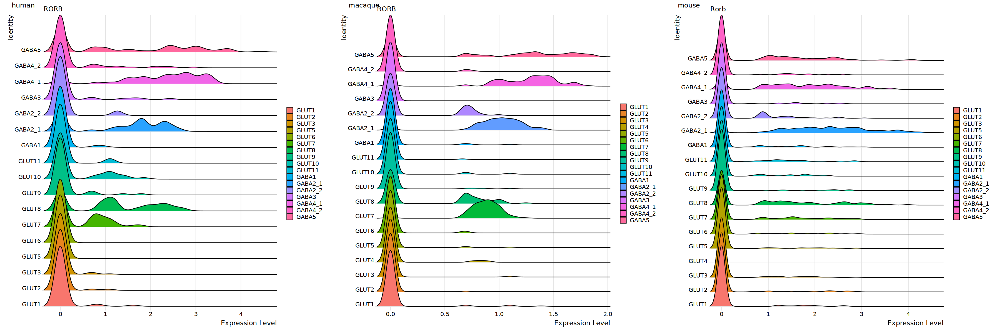

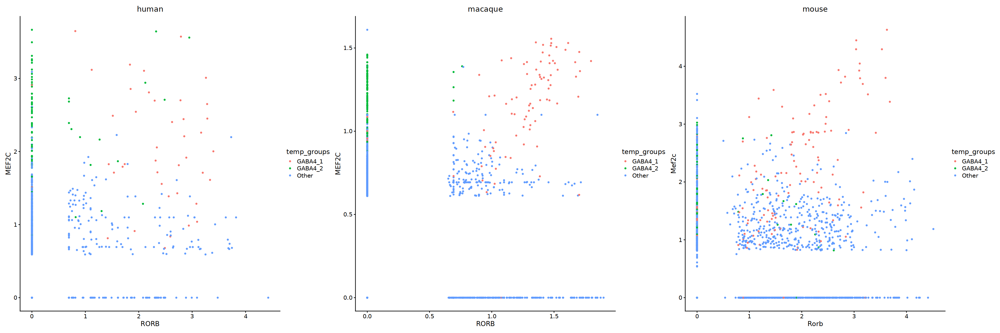

In [32]:
features = c('MEF2C', 'RORB')#, 'BCL11A','BRINP3','GPC5','LY6H','MEF2C','NETO2','SERPINE2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA4_1'
opponent = 'GABA4_2'
feature1 = 'RORB'
features = c('MEF2C')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

# GABA 4_2: NXPH1 and SDK2

Picking joint bandwidth of 0.203

Picking joint bandwidth of 0.0443

Picking joint bandwidth of 0.199

Picking joint bandwidth of 0.18

Picking joint bandwidth of 0.0755

Picking joint bandwidth of 0.0804



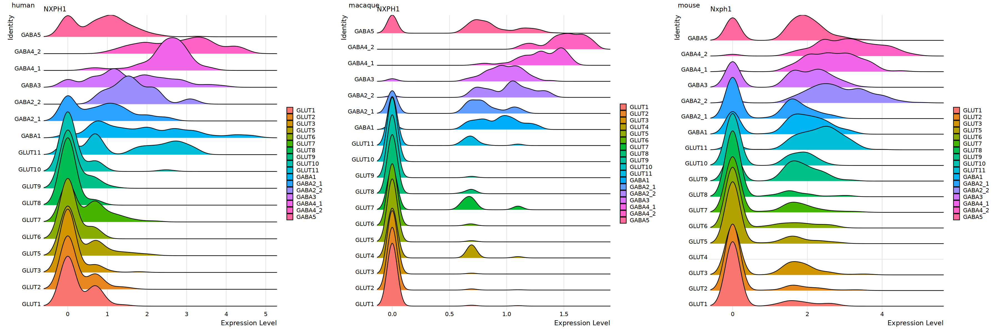

[1] "NXPH1"


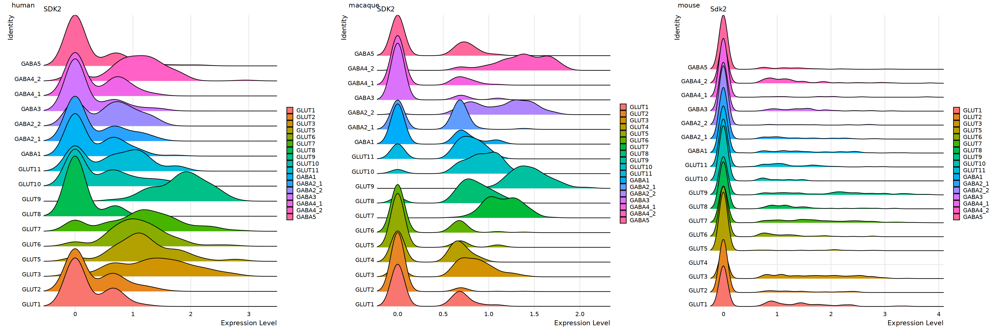

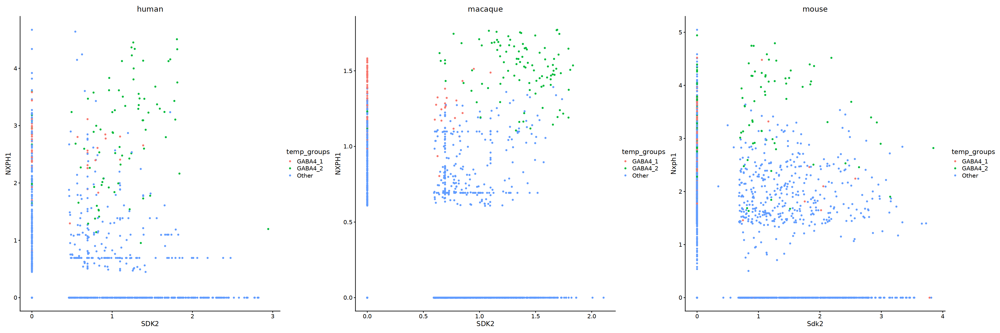

In [33]:
features = c('NXPH1', 'SDK2')#, 'BCL11A','BRINP3','GPC5','LY6H','MEF2C','NETO2','SERPINE2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA4_1'
opponent = 'GABA4_2'
feature1 = 'SDK2'
features = c('NXPH1')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,opponent)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus,opponent)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus,opponent)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

# GABA5: PDYN + PTPRK. Showing NFIB and ZEB2 which also work

Picking joint bandwidth of 0.0351

Picking joint bandwidth of 0.00992

Picking joint bandwidth of 0.0112

Picking joint bandwidth of 0.24

Picking joint bandwidth of 0.0654

Picking joint bandwidth of 0.124

Picking joint bandwidth of 0.206

Picking joint bandwidth of 0.0322

Picking joint bandwidth of 0.0434



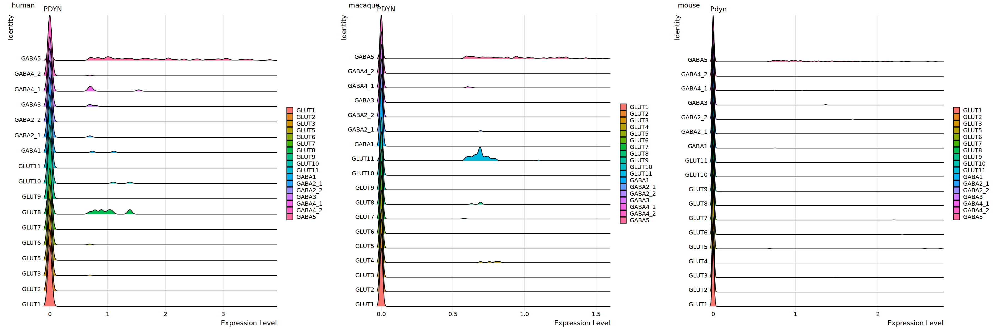

Picking joint bandwidth of 0.22

Picking joint bandwidth of 0.0175

Picking joint bandwidth of 0.257



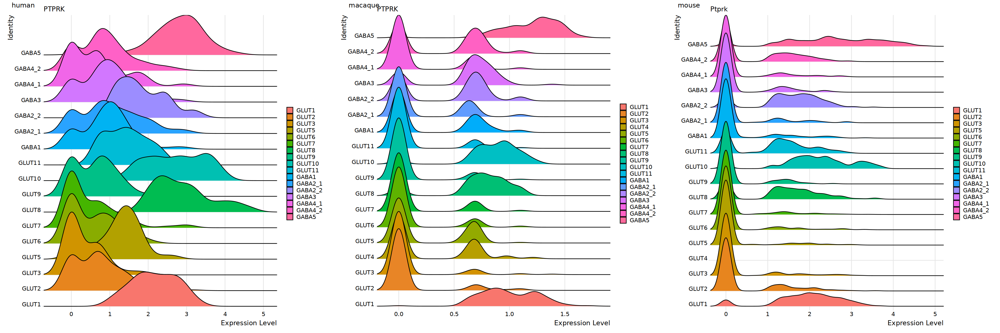

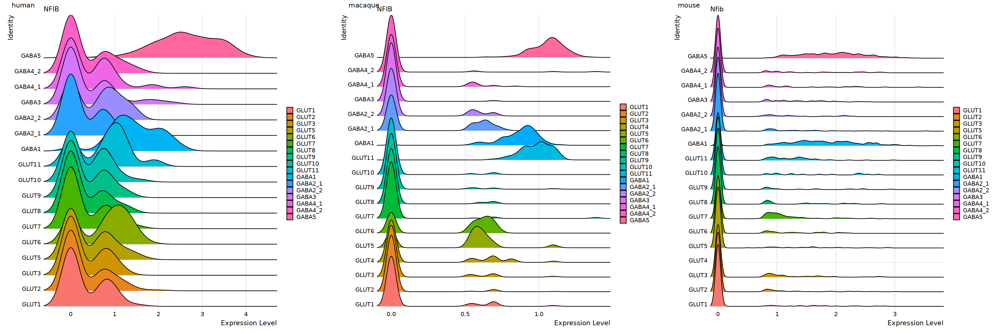

[1] "PTPRK"


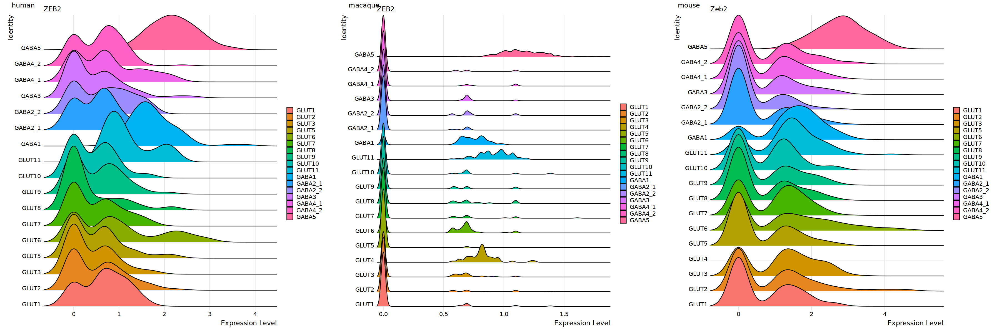

[1] "NFIB"


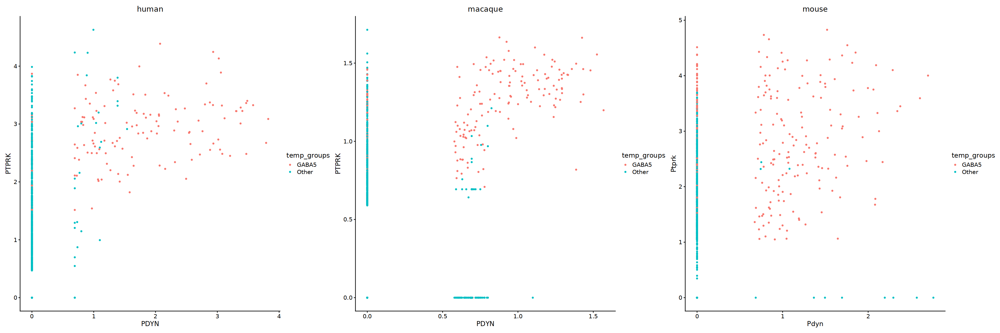

[1] "ZEB2"


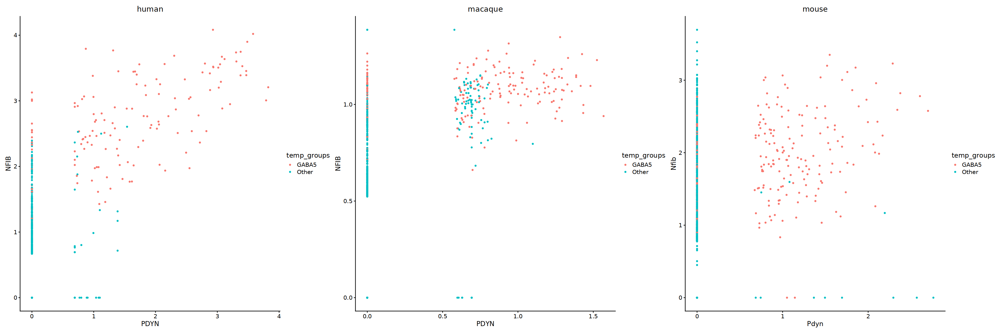

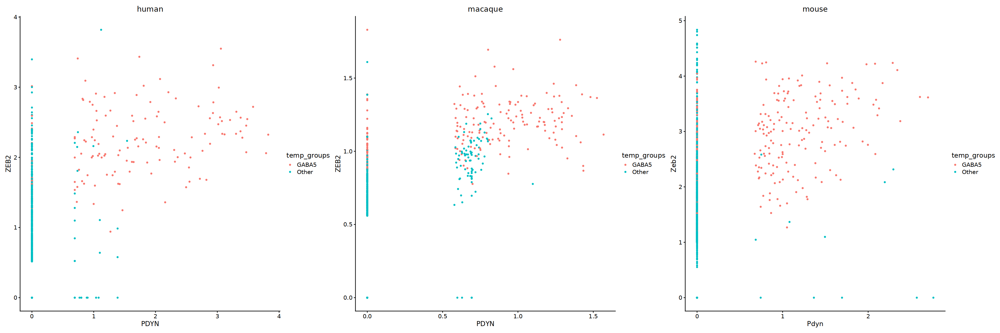

In [34]:
# GABA5: PDYN + PTPRK. NFIB would also work well. I like PTPRK for being complementary to PDYN in mouse and macaque

features = c('PDYN','PTPRK','NFIB', 'ZEB2')
mouse_features = as.character(HgtoMm[features])

for (ii in 1:length(features)){
    feature = features[ii]
    mouse_feature = mouse_features[ii]
    h = RidgePlot(human_rna_dh, features = feature)
    mac = RidgePlot(macaque_rna_dh, features = feature)
    mouse = RidgePlot(mouse_rna, features = mouse_feature)

    fig=ggarrange(h,mac,mouse,
                    labels = c("human", "macaque", "mouse"),
                    ncol = 3, nrow = 1)
    print(fig)

}

## scatter
focus = 'GABA5'
feature1 = 'PDYN'
features = c('PTPRK')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GABA5'
feature1 = 'PDYN'
features = c('NFIB')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}

## scatter
focus = 'GABA5'
feature1 = 'PDYN'
features = c('ZEB2')

for (ii in 1:length(features)){
    feature2 = features[ii]
    print(feature2)
    h = FeatureScatterFunction('human', human_rna_dh, feature1, feature2,focus,)
    mac = FeatureScatterFunction('macaque', macaque_rna_dh, feature1, feature2,focus)
    mouse = FeatureScatterFunction('mouse',mouse_rna, feature1, feature2,focus)
    print(h + mac + mouse)
    #print(h + mac)
    #print(mac)
    #print(mouse)
    
}